In [17]:
from functions_py import *
import matplotlib.pyplot as plt
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy.ma as ma
import pandas as pd 
# import cv2
import skimage as sk
from sympy import Ellipse, Point

def gaussian(x, a, mean, sigma):
    return a * np.exp(-((x - mean)**2 / (2 * sigma**2)))

def EnergySpectrum(x, N):
    return N * np.sin(x)*np.cos(x)**3

In [2]:
plt.rcParams.update({
    "image.origin": "lower",
    "image.aspect": 1,
    #"text.usetex": True,
    "grid.alpha": .5,
    "axes.linewidth":2,
    "lines.linewidth" : 1,
    "font.size":    15.0,
    "xaxis.labellocation": 'right',  # alignment of the xaxis label: {left, right, center}
    "yaxis.labellocation": 'top',  # alignment of the yaxis label: {bottom, top, center}
    "xtick.top":           True ,  # draw ticks on the top side
    "xtick.major.size":    8    ,# major tick size in points
    "xtick.minor.size":    4      ,# minor tick size in points
    "xtick.direction":     'in',
    "xtick.minor.visible": True,
    "ytick.right":           True ,  # draw ticks on the top side
    "ytick.major.size":    8    ,# major tick size in points
    "ytick.minor.size":    4      ,# minor tick size in points
    "ytick.direction":     'in',
    "ytick.minor.visible": True,
    "ytick.major.width":   2   , # major tick width in points
    "ytick.minor.width":   1 ,
    "xtick.major.width":   2   , # major tick width in points
    "xtick.minor.width":   1 ,
    "legend.framealpha": 0 ,
    "legend.loc": 'best',

})

# MIT images

## Raw Image

Filename: /home/oem/datosFits/spuriousCharge/Microchip/14AUG23/proc_skp_module24_MITLL01_externalVr-4_Vv2_T140__NSAMP225_NROW650_NCOL700_EXPOSURE0_NBINROW1_NBINCOL1_img109.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     165   (700, 650)   float32   
  1                1 ImageHDU       164   (700, 650)   float32   
  2                1 ImageHDU       164   (700, 650)   float32   
  3                1 ImageHDU       164   (700, 650)   float32   
None
----------------


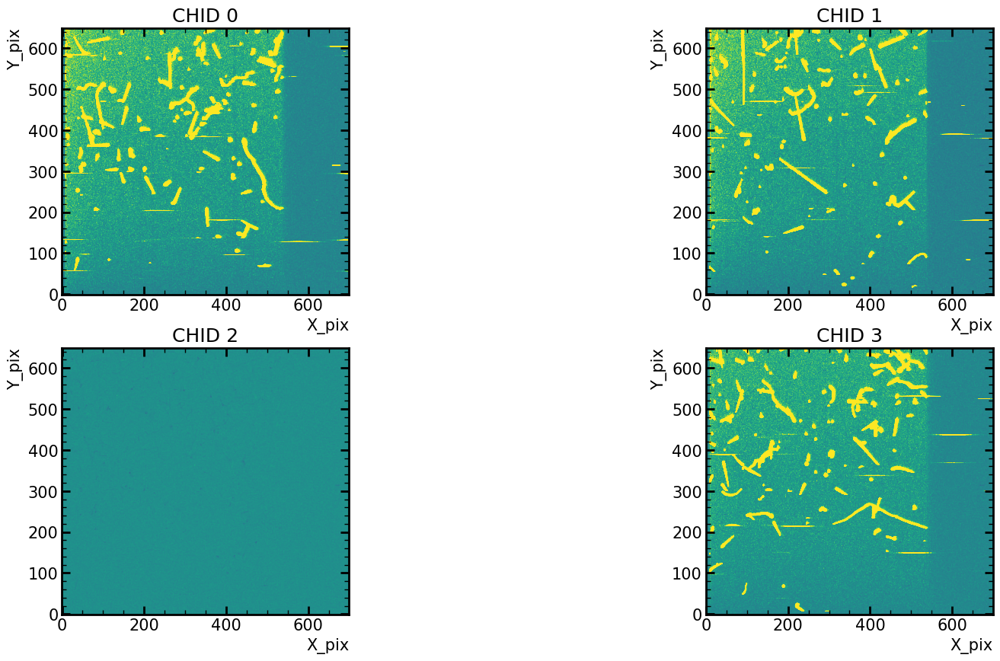

In [3]:

path = '/home/oem/datosFits/spuriousCharge/Microchip/14AUG23/proc_skp_module24_MITLL01_externalVr-4_Vv2_T140__NSAMP225_NROW650_NCOL700_EXPOSURE0_NBINROW1_NBINCOL1_img109.fits'

hdu_list = fits.open(path)
print(hdu_list.info())
print('----------------')
# hdu_list[0].header
plt.figure(figsize=(20,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(hdu_list[i].data-np.median(hdu_list[i].data),vmin=-800,vmax=800)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
plt.show()

In [4]:
hdu_path = path.split('_')
# int(hdu_path[15])

## Calibrated imges, medians subtracted, cleaned xtalk

[32.84776057]
[26.83791537]
Error - Xtalk fit failed on local calib
CHID 0 Gain:(220.09 +- 1.46)ADUs
CHID 1 Gain:(217.91 +- 1.50)ADUs
CHID 2 Gain:(172.96 +- 138.90)ADUs
CHID 3 Gain:(201.27 +- 1.22)ADUs


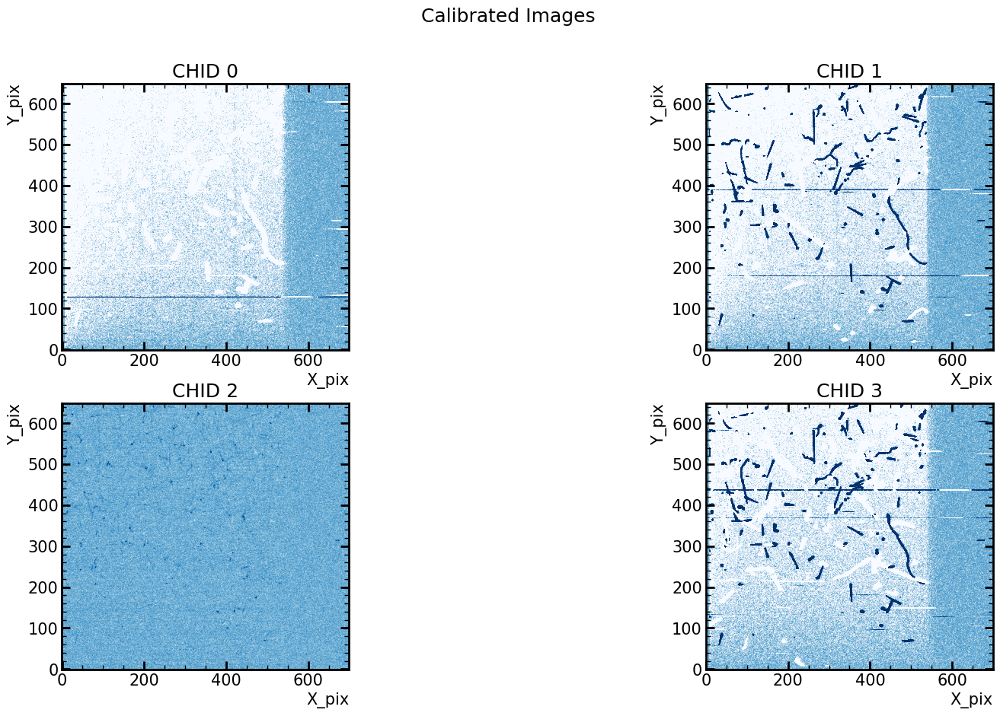

In [5]:
data_pre = precal(hdu_list,extensions=4)
gain, gain_err, data= LocalCalib(data_pre,extensions=4)
fig=plt.figure(figsize=(20,10))
cmap = mpl.cm.Blues_r
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(data[i],cmap=cmap,vmin=-1,vmax=1)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
    print("CHID "+str(i)+' Gain:({:.2f} +- {:.2f})ADUs'.format(gain[i],gain_err[i]))
plt.suptitle('Calibrated Images')
#plt.savefig('IMAGES_POSCALIB.png', bbox_inches='tight', dpi=100)
    
plt.show()

    

13428.85063329544
13428.85063329544


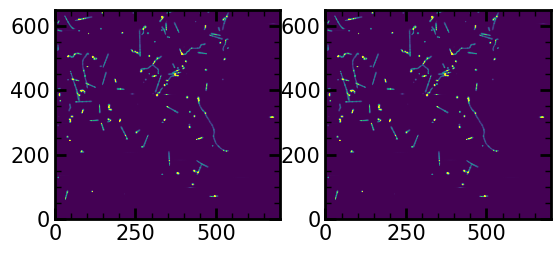

In [6]:
plt.subplot(121)
plt.imshow(data_pre[0],vmin=0,vmax=1000)
plt.subplot(122)
plt.imshow(data[0],vmin=0,vmax=1000)

print(str(data_pre[0].max()))
print(str(data.max()))

In [7]:
sigma, sigma_err = LocalSigma(data,extensions=4)
for i in range(4):
    print('CHID '+str(i),r' Noise: ({:.3f} +- {:.3f}) e-'.format(sigma[i],sigma_err[i]))

CHID 0  Noise: (0.224 +- 0.002) e-
CHID 1  Noise: (0.229 +- 0.002) e-
CHID 2  Noise: (0.270 +- 0.003) e-
CHID 3  Noise: (0.236 +- 0.002) e-


# Masking

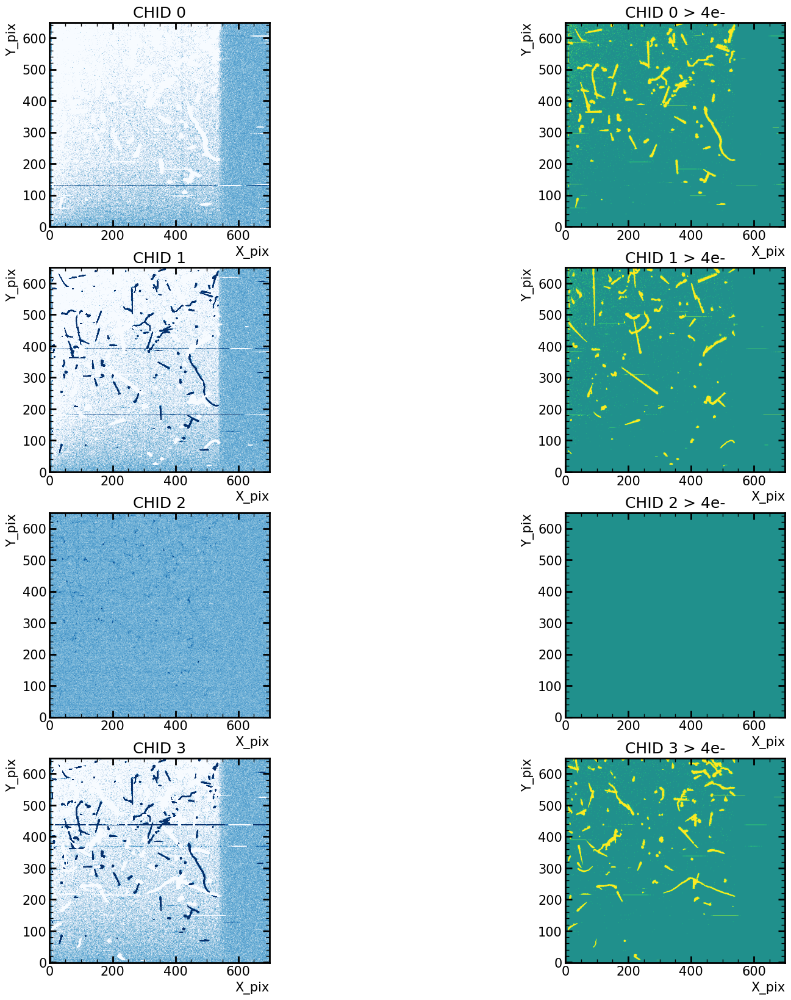

In [8]:
fig=plt.figure(figsize=(20,20))
for i in range(4):
    plt.subplot(4,2,2*(i+1)-1)
    plt.imshow(data[i],cmap=cmap, vmin=-1,vmax=1)
    plt.title('CHID '+str(i))
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
    plt.subplot(4,2,2*(i+1))
    plt.imshow(data[i]>4,vmin=-1,vmax=1)
    plt.title('CHID '+str(i)+' > 4e-')
    plt.ylabel('Y_pix')
    plt.xlabel('X_pix')
    # cax = plt.axes([0.85, 0.1, 0.075, 0.8])
    # plt.colorbar(cax=cax)
plt.show()

In [9]:
oScan=hdu_list[0].data[:,530:]
# oScan = oScan.flatten()
overscan_mean = oScan.max()
print(overscan_mean)

1804140.8


In [10]:
import skimage.measure as sk

### Etiqueta cada uno de los eventos
### y, utilizando __imshow__ podemos mostrar el numero del eventos dentro de la imagen

# Pruebas cambiando el número de sigma o la estructura

In [11]:
n_sigma = 10
n_label = 0
sigma = 400

plt.figure(figsize=(10,10))

label, n_events =ndimage.label(data>n_sigma*sigma,structure=[[1,1,1],[1,1,1],[1,1,1]])
plt.subplot(1,2,1)
plt.imshow(label==n_label, cmap='gray', vmax=1,vmin=0)

list_n_events = []
for i in range(0,n_events):
    list_n_events.append(i+1)

# print(label==35)
print(n_events)
# # print(list_n_events)

label, n_events =ndimage.label(data>n_sigma*sigma,structure=[[1,1,0],[0,1, 0],[0,1,1]])
list_n_events = []
for i in range(0,n_events):
    list_n_events.append(i+1)
print(n_events)

plt.subplot(1,2,2)
plt.imshow(label==11, cmap='gray', vmax=1,vmin=0)

RuntimeError: structure and input must have equal rank

<Figure size 1000x1000 with 0 Axes>

# Prueba de la suma de carga de un evento ficticio

1
[[-- -- -- -- --]
 [-- 10 10 10 --]
 [-- 10 40 10 --]
 [-- 10 10 10 --]
 [-- -- -- -- --]]
120


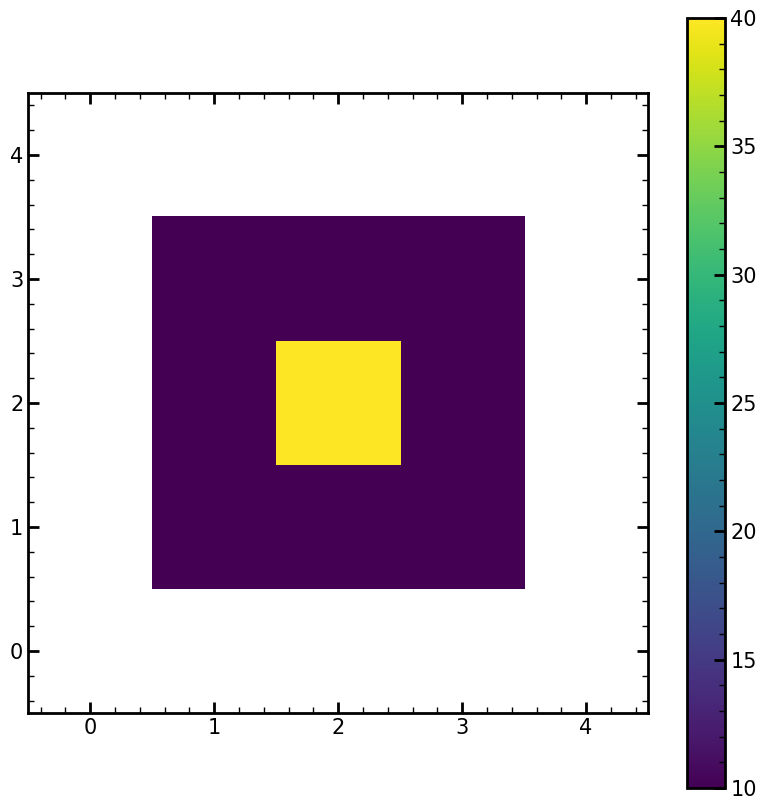

In [12]:
ficticio = np.array([[2,2,2,2,2,2,2,2,2,2,2], [2,2,2,2,2,2,2,2,2,2,2],[2,2,2,2,10,10,10,2,2,2,2],[2,2,2,2,10,40,10,2,2,2,2],[2,2,2,2,10,10,10,2,2,2,2], [2,2,2,2,2,2,2,2,2,2,2], [2,2,2,2,2,2,2,2,2,2,2]])
labelfic, n_eventsfic = ndimage.label(ficticio>2,structure=[[1,1,1],[1,1,1],[1,1,1]])
print(n_eventsfic)
# plt.figure(figsize=(10,10))
# plt.imshow(labelfic==0, cmap='gray', vmax=1,vmin=0)
locfic = ndimage.find_objects(labelfic==1)[0]
extra = 1
# print(locfic[0].start)
# print(locfic[1].stop)
# print(locfic)

# plt.imshow(ficticio[locfic[0].start-extra:locfic[0].stop+extra, locfic[1].start-extra:locfic[1].stop+extra], cmap='viridis')
mask_fict = np.invert(labelfic==1)
# print(mask_fict)

plt.figure(figsize=(10,10))
ficticio_mask = ma.masked_array(ficticio[locfic[0].start-extra:locfic[0].stop+extra, locfic[1].start-extra:locfic[1].stop+extra], mask_fict[locfic[0].start-extra:locfic[0].stop+extra, locfic[1].start-extra:locfic[1].stop+extra])
print(ficticio_mask)
plt.imshow(ficticio_mask, cmap='viridis')
plt.colorbar()

print(ficticio_mask.sum())

(3.0, 2.5)
Coordenada X:  2.5
Coordenada Y:  3.0


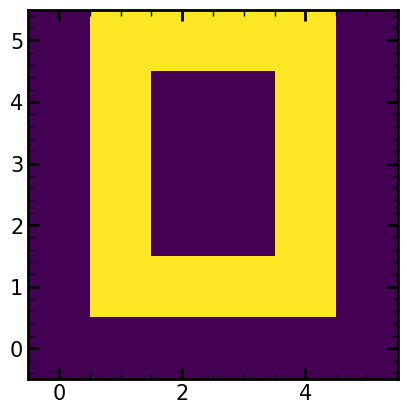

In [ ]:
fict = np.array([[0,0,0,0,0,0], [0,1,1,1,1,0],[0,1,0,0,1,0],[0,1,0,0,1,0], [0,1,0,0,1,0], [0,1,1,1,1,0]])
# fict = np.array([[0,0,0,0,0,0], [0,0,0,0,0,0],[0,0,0,1,0,0],[0,0,0,0,0,0], [0,0,0,0,0,0], [0,0,0,0,0,0], [0,0,0,0,0,0]])

plt.imshow(fict)

coord = ndimage.center_of_mass(fict) # Regresa una tupla con las coordenadas (Y,X)
print(coord)
print("Coordenada X: ", coord[1] )
print("Coordenada Y: ", coord[0] ) 

# Prueba de Localización de Eventos con una forma en especial

/tmp/ipykernel_23735/2050643588.py:2: UserWarning: No contour levels were found within the data range.
  plt.contour(fict,0,colors='red')


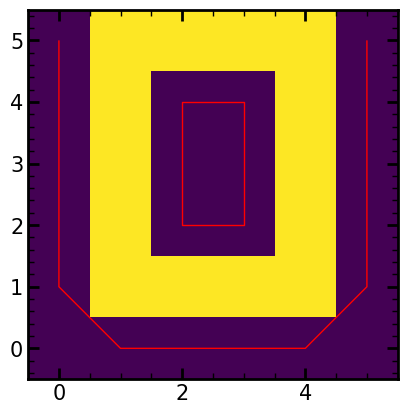

In [ ]:
plt.imshow(fict)
plt.contour(fict,0,colors='red')

# Normalizando y calibrando los datos para obtener la sigmna 

Centroide:  0.645317254511065  Amplitud:  435227.0 sigma:  1.0


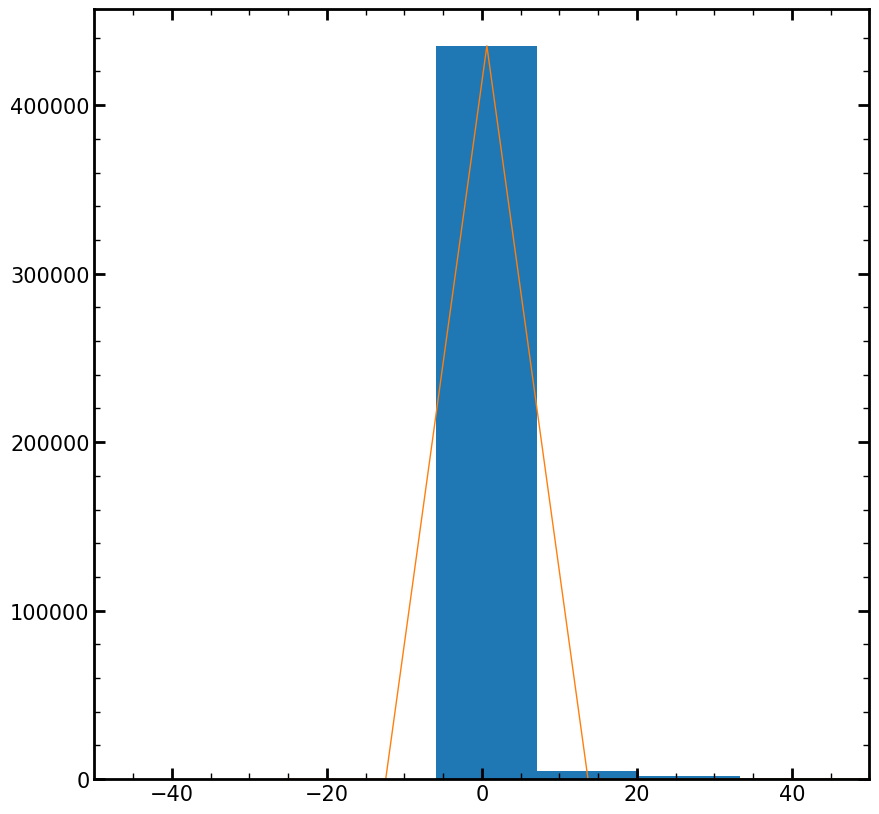

In [13]:
extension = 1
Bins = 1000

data = hdu_list[extension-1].data
header=hdu_list[extension-1].header
oScan=hdu_list[extension-1].data[638:,530:]

lineavert_ext1 = hdu_list[0].data[520:640, 0:11]

nsamp=float(header['NSAMP'])
expgain = [227, 220.4, 94.72, 197.7]

#Aplanar la imágen
fig_all, axs_all = plt.subplots(1, 1, figsize=(10, 10))
hist , bins_edges = np.histogram(oScan.flatten(), bins = Bins)
offset = bins_edges[np.argmax(hist)]
# data = 
dataP = data-offset
dataCal = dataP/expgain[extension-1] ## En electrones

bin_heights, bin_borders, _ = axs_all.hist(dataCal.flatten(), bins= Bins)#, log=True)#,  range=[-200000, 1000000])
bin_centers=np.zeros(len(bin_heights), dtype=float)
offset_fit = bin_borders[np.argmax(bin_heights)]
for p in range(len(bin_heights)):
    bin_centers[p]=(bin_borders[p+1]+bin_borders[p])/2

xmin_fit, xmax_fit = offset_fit-(10*expgain[extension-1])/math.sqrt(nsamp), offset_fit+(10*expgain[extension-1])/math.sqrt(nsamp)			# Define fit range
bin_heights = bin_heights[(bin_centers>xmin_fit) & (bin_centers<xmax_fit)]
bin_centers = bin_centers[(bin_centers>xmin_fit) & (bin_centers<xmax_fit)]

popt, pcov = curve_fit(gaussian, bin_centers, bin_heights, p0=[np.max(bin_heights), 0, 1], maxfev=100000)		# Fit histogram with gaussian
axs_all.plot(bin_centers, gaussian(bin_centers, *popt))	


plt.xlim(-50,50)
# plt.ylim(0, 100)
# axs_all.set_yscale('log')
# plt.show()

print('Centroide: ',popt[1], ' Amplitud: ', popt[0], 'sigma: ', popt[2]) #gaussian(x, a, mean, sigma)
# n_events
# print(popt)
# dataP
# print(header['RUNID'])

# All Events DataFrame 

In [14]:
list_Runid = []
list_ext = []
list_Matrix_Slice_Event = []
list_Size_Matrix_Event = []
list_event_size = []
list_charge = []
list_mean_charge = []
list_Barycenter= []
list_n_events = []

extension = 1 ## Extension's number
extra = 0
# data = hdu_list[extension-1].data
header = hdu_list[extension-1].header
Runid = str(int(header['RUNID']))

oScan=hdu_list[extension-1].data[638:,530:]
expgain = [227, 220.4, 94.72, 197.7]

hist , bins_edges = np.histogram(oScan.flatten(), bins = 1000000)
offset = bins_edges[np.argmax(hist)]
dataP = data-offset ## Datos aplanados
dataCal = dataP/expgain[extension-1] ## Datos normalizados en electrones

label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[1,1,1],[1,1,1],[1,1,1]])
# label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[1,0,1],[1,1,1],[1,0,1]])
# label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[0,1,0],[1,1,1],[0,1,0]])


## Obteniendo el valor promedio del fondo
fondo_mask = np.invert(label==0)
fondo = ma.masked_array(dataCal,fondo_mask)
# print(fondo)
valor_promedio_fondo = fondo.data.mean()
# print(valor_promedio_fondo)
# plt.imshow(fondo, cmap='gray')
# plt.colorbar()


for i in range(0,n_events):
    list_n_events.append(i+1)

for i in range(1,n_events+1):
    mask = np.invert(label==i)
    loc = ndimage.find_objects(label==i)[0]
    
    data_maskEvent = ma.masked_array(dataCal[loc[0].start-extra:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra], mask[loc[0].start-extra:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra])
    if len(data_maskEvent)<1:
        list_Size_Matrix_Event.append('NaN')
    
    # elif data_mask.data.shape[1]==0 or data_mask.data.shape[0]==0:
    #     list_Size_Matrix_Event.append('NaN')

    else:
        ## Número de imagen
        list_Runid.append(Runid)

        ## Número de Extensión
        list_ext.append(extension)

        ## Lista de Coordenadas de cada evento
        list_Size_Matrix_Event.append(str(data_maskEvent.shape[1])+'x'+str(data_maskEvent.shape[0])) ## La dimensión de la matriz del evento en pixeles
        
        event_size = 0
        # Obtiene los pixeles que componen al evento
        for i in range(0,len(data_maskEvent.flatten())):
            if data_maskEvent.flatten()[i]:
                event_size = event_size+1
        list_event_size.append(int(event_size))
        # print(list_event_size)

        # Obtiene la carga total del evento en electrones
        charge = 0
        for i in data_maskEvent.data.flatten():
            if i >= valor_promedio_fondo:
                charge = charge + i
        # list_charge.append(data_maskEvent.sum())
        list_charge.append(charge)

        # Carga promedio en electrones
        try:
            mean_charge = charge/event_size
            list_mean_charge.append(round(mean_charge,3))
        except:
            # list_mean_charge.append('None Event Size')
            continue
        

        ## Centro de carga
        # centerCharge = ndimage.center_of_mass(data[1][loc])
        coordX_centerCharge = round(ndimage.center_of_mass(data_maskEvent)[1],4)
        coordY_centerCharge = round(ndimage.center_of_mass(data_maskEvent)[0],4)
        list_coordCenterCharge = [coordX_centerCharge, coordY_centerCharge]
        # print(centerMass)
        list_Barycenter.append(list_coordCenterCharge)

        # list_centerCharge.append(centerCharge)
        # print(list_centerCharge)

## DataFrame de Cada evento
print('Events: '+ str(list_n_events[-1]))
RunidFrame = pd.DataFrame(list_Runid, columns = ['Image ID'])
ExtensionFrame = pd.DataFrame(list_ext, columns = ['Extension'])
Event_IDFrame= pd.DataFrame(list_n_events, columns = ['Event ID'])
Matrix_Size_EventFrame = pd.DataFrame(list_Size_Matrix_Event, columns = ['Matrix Size (px)'])
Event_SizeFrame = pd.DataFrame(list_event_size, columns = ['Event Size (px)'])
ChargeFrame = pd.DataFrame(list_charge, columns = ['Total Charge (e-)'])
MeanChargeFrame = pd.DataFrame(list_mean_charge, columns = ['Mean Charge (e-)'])
# CenterChargeFrame = pd.DataFrame(list_centerCharge, columns =['Center of Charge'])

totalFrame =pd.concat([Event_IDFrame,RunidFrame, ExtensionFrame, Matrix_Size_EventFrame, Event_SizeFrame, ChargeFrame, MeanChargeFrame], axis = 1 )
totalFrame['Barycenter (px)']=pd.Series(list_Barycenter)

TF = totalFrame.set_index('Event ID')
TF[20:50]
# TF.query('Event Size (px) >= 200')
# totalFrame.style.hide_index()

Events: 634


,Image ID,Extension,Matrix Size (px),Event Size (px),Total Charge (e-),Mean Charge (e-),Barycenter (px)
Event ID,,,,,,,
21,109,1,1x1,1,0.000000,0.000,"[0.0, 0.0]"
22,109,1,7x1,7,0.000000,0.000,"[3.2234, 0.0]"
23,109,1,1x1,1,0.000000,0.000,"[0.0, 0.0]"
24,109,1,1x1,1,0.000000,0.000,"[0.0, 0.0]"
25,109,1,12x9,76,33372.504265,439.112,"[4.3165, 3.8729]"
26,109,1,1x1,1,0.000000,0.000,"[0.0, 0.0]"
27,109,1,3x6,14,8737.076321,624.077,"[0.4045, 2.1341]"
28,109,1,4x1,4,0.000000,0.000,"[1.4899, 0.0]"
29,109,1,56x1,56,1520.792625,27.157,"[28.3621, 0.0]"


# Visualizar un evento en la imagen original, solo su "rebanada" y la "rebanada" enmascarada

Event Slice:
x: [0,43]
y: [134,135]


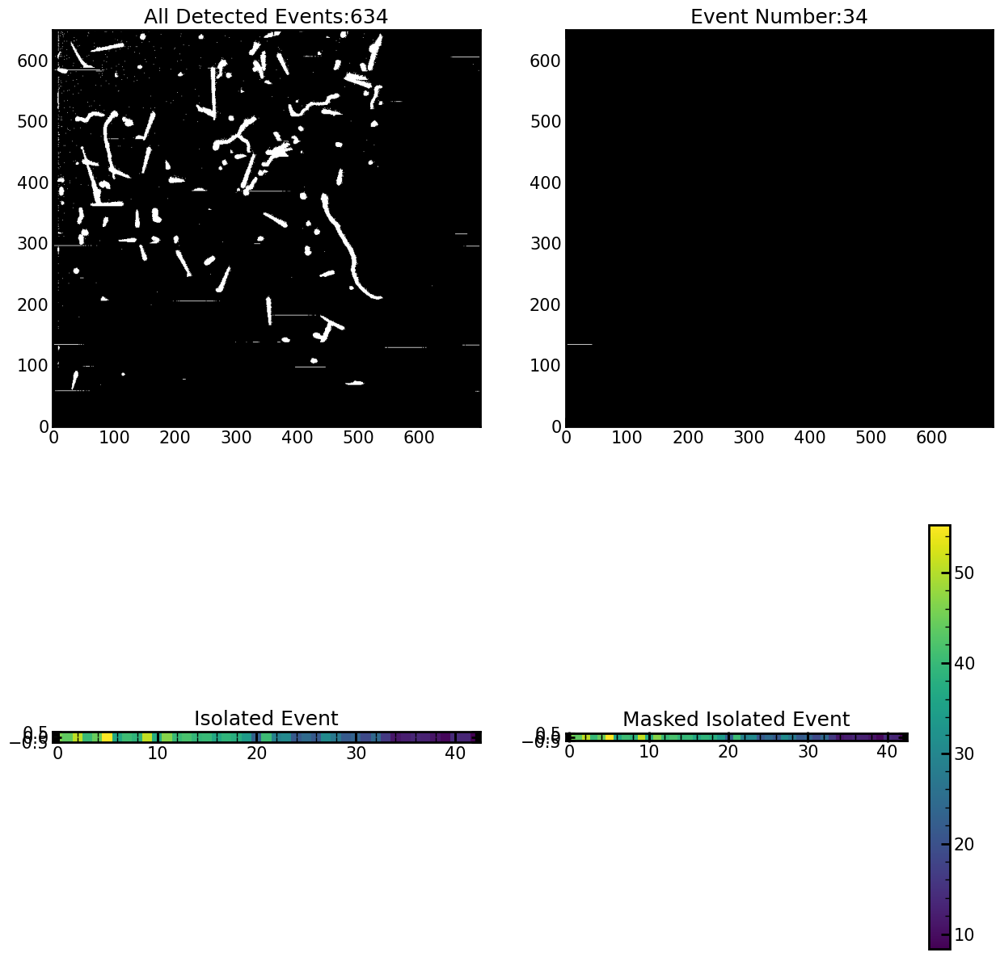

,Image ID,Extension,Matrix Size (px),Event Size (px),Total Charge (e-),Mean Charge (e-),Barycenter (px)
Event ID,,,,,,,
34,109,1,43x1,43,1192.042107,27.722,"[16.0061, 0.0]"


In [15]:
n_label = 34
extra = 0
label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[1,1,1],[1,1,1],[1,1,1]]) # 48
# label, n_events = ndimage.label(dataCal>6*abs(popt[2]),structure=[[0,1,0],[1,1,1],[0,1,0]]) ## 50, 52

loc = ndimage.find_objects(label==n_label)[0]

fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(15,15))
# fig.suptitle('Event Number '+ str(n_label))
## Imagen original
axs[0,0].set_title('All Detected Events:'+str(n_events))
axs[0,0].imshow(label==0, cmap='gist_yarg', vmax=1,vmin=0, origin='lower')
# plt.suptitle('Primer Imagen')

## Evento en la imagen original
axs[0,1].set_title('Event Number:'+str(n_label))
axs[0,1].imshow(label==n_label, cmap='gray', vmax=1,vmin=0, origin='lower')

if loc[0].start == 0:
    axs[1,0].set_title('Isolated Event')
    x1 = axs[1,0].imshow(dataCal[loc[0].start:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra], cmap='viridis', origin='lower')#, vmax=overscan_mean+30000,vmin=overscan_mean+11000)
    
    mask_35 = np.invert(label==n_label)
    data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra], mask_35[loc[0].start:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra])
    axs[1,1].set_title('Masked Isolated Event')
    x2 = axs[1,1].imshow(data_mask, cmap='viridis', origin='lower')
    # fig.colorbar(x1, ax=axs[1,0])
    fig.colorbar(x2, ax=axs[1,1])
    
elif loc[1].start == 0:
    axs[1,0].set_title('Isolated Event')
    x1 = axs[1,0].imshow(dataCal[loc[0].start-extra:loc[0].stop+extra, loc[1].start:loc[1].stop+extra], cmap='viridis', origin='lower')#, vmax=overscan_mean+30000,vmin=overscan_mean+11000)

    mask_35 = np.invert(label==n_label)
    data_mask = ma.masked_array(dataCal[loc[0].start-extra:loc[0].stop+extra, loc[1].start:loc[1].stop+extra], mask_35[loc[0].start-extra:loc[0].stop+extra, loc[1].start:loc[1].stop+extra])
    axs[1,1].set_title('Masked Isolated Event')
    x2 = axs[1,1].imshow(data_mask, cmap='viridis', origin = 'lower')#, vmax=overscan_mean+30000,vmin=overscan_mean+11000)
    # fig.colorbar(x1, ax=axs[1,0])
    fig.colorbar(x2, ax=axs[1,1])

else: 
    axs[1,0].set_title('Isolated Event')
    x1 = axs[1,0].imshow(dataCal[loc[0].start-extra:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra], cmap='viridis', origin = 'lower')
    # plt.colorbar()
    
    mask_35 = np.invert(label==n_label)
    data_mask = ma.masked_array(dataCal[loc[0].start-extra:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra], mask_35[loc[0].start-extra:loc[0].stop+extra, loc[1].start-extra:loc[1].stop+extra])
    axs[1,1].set_title('Masked Isolated Event')
    x2 = axs[1,1].imshow(data_mask, cmap='viridis', origin='lower')
    axs[1,1].plot(totalFrame.iat[n_label-1, 7][0], totalFrame.iat[n_label-1, 7][1], 'ro') ## Plot the baricentrum
    # plt.legend('Baricentrum')

    fig.colorbar(x1, ax=axs[1,0])
    fig.colorbar(x2, ax=axs[1,1])
    # fig.colorbar(axs[1,1], ax=[[x1,x2]], location = 'bottom', fraction = .1)

print('Event Slice:'  )
print('x: ['+str(loc[1].start)+','+str(loc[1].stop)+']')
print('y: ['+str(loc[0].start)+','+str(loc[0].stop)+']')
# print(loc)
# print(totalFrame.set_index('Event ID').iloc[[n_label-1]])
plt.show()
totalFrame.set_index('Event ID').iloc[[n_label-1]]

# Pruebas de Contorno de Eventos

## Utilizando 'plt.contour'

(slice(57, 58, None), slice(698, 700, None))


TypeError: Input z must be at least a (2, 2) shaped array, but has shape (1, 2)

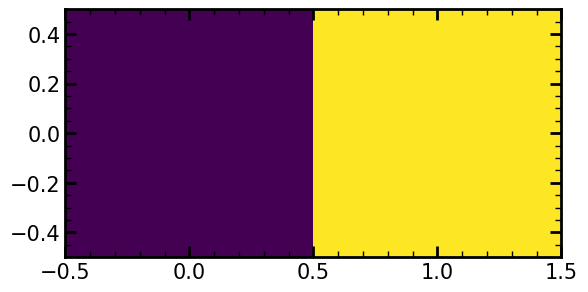

In [ ]:
### UTILIZR LA NUEVA LIBRERIA OPENCV ###


n_label = 3
label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[1,1,1],[1,1,1],[1,1,1]])

loc = ndimage.find_objects(label==n_label)[0]
print(loc)

# maxim = ndimage.maximum(loc)
# print(maxim)
# plt.imshow(dataCal[loc[0].start:loc[0].stop,  loc[1].start:loc[1].stop])
mask_35 = np.invert(label==n_label)
data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
# plt.imshow(dataCal[maxim.start:maxim.stop])
plt.imshow(data_mask)

# cv2.imshow('hola', dataCal[loc[0].start:loc[0].stop,  loc[1].start:loc[1].stop])
# Cont = plt.contour(dataCal[loc[0].start:loc[0].stop,  loc[1].start:loc[1].stop],1,colors='orange')
Conto = plt.contour(mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop],2,  colors='red')
# plt.contour(data_mask.data,colors='red')
# plt.contour(data_mask,colors='red')
# print(Cont.origin)

## Utilizando 'measure.find_contours()'

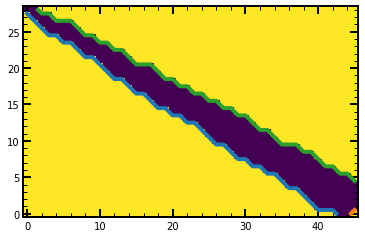

In [ ]:
# ret, thresh = cv2.threshold(data_mask, 127, 255, 0)
# contours, hierarchy = cv2.findContours(thresh)
contours = sk.measure.find_contours(data_mask.mask, fully_connected='high')

fig, ax = plt.subplots()
ax.imshow(data_mask.mask)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=4)
# plt.plot(Cont)

## Utilizando la libreria 'skimage.measure'

Centroide:  (134.0, 46.5)
Radio mayor:  2.0
Radio menor:  0.0
Centroid Weighted:  (134.0, 46.513358054799404)
Label:  36
Orientation:  1.5707963267948966
Slice:  (slice(134, 135, None), slice(46, 48, None))
Eccentricity:  1.0


(41.0, 53.0, 129.0, 140.0)

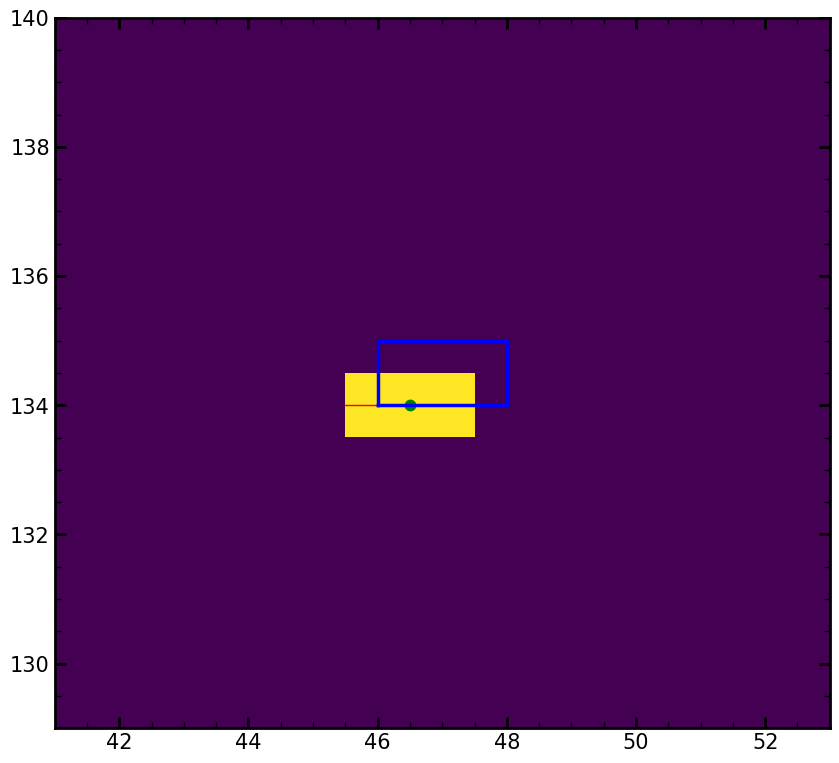

In [18]:
n_label= 36
fig, ax = plt.subplots(figsize=(10,10))

label_img, nlabels_img = sk.measure.label(dataCal>6*popt[2], background=6*popt[2], connectivity=2, return_num=True)
# print(nlabels_img)
ax.imshow(label_img==n_label) # Matriz centrada en el origen

prop = sk.measure.regionprops(label_img,dataCal)
# prop = sk.measure.regionprops(label_img)

# loc = ndimage.find_objects(label==n_label)[0]
loc = prop[n_label-1].slice

mask_35 = np.invert(label_img==n_label)
# ax.imshow(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])

data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
# plt.imshow(dataCal[maxim.start:maxim.stop])
# ax.imshow(data_mask)


print("Centroide: ", prop[n_label-1].centroid)
print("Radio mayor: ", prop[n_label-1].axis_major_length)
print("Radio menor: ", prop[n_label-1].axis_minor_length)
# print("Centroide Local: ", prop[n_label-1].centroid_local)
print('Centroid Weighted: ', prop[n_label-1].centroid_weighted)
# print(prop[n_label-1].centroid_weighted_local)
# print(prop[n_label-1].coords_scaled)
# print(prop[n_label-1].coords)
# print(prop[n_label-1].extent)
# print(prop[n_label-1].image)
# print(prop[n_label-1].image_intensity)
print('Label: ', prop[n_label-1].label)
print('Orientation: ', prop[n_label-1].orientation)
print('Slice: ', prop[n_label-1].slice)
print('Eccentricity: ', prop[n_label-1].eccentricity)
# print('Inertia tensor: ', prop[n_label-1].inertia_tensor)
# print('Intensity Max: ', prop[n_label-1].intensity_max)

## Ellipse 
y0, x0 = prop[n_label-1].centroid
# y0, x0 = prop[n_label-1].centroid_weighted

orientation = prop[n_label-1].orientation
rotation = orientation*1
x1 = x0 + math.cos(orientation) * 0.5 * prop[n_label-1].axis_minor_length
y1 = y0 - math.sin(orientation) * 0.5 * prop[n_label-1].axis_minor_length

x2 = x0 - math.sin(orientation) * 0.5 * prop[n_label-1].axis_major_length
y2 = y0 - math.cos(orientation) * 0.5 * prop[n_label-1].axis_major_length # Ellipse's major radio

x3 = x0 - math.sin(-orientation) * 0.5 * prop[n_label-1].axis_major_length
y3 = y0 + math.cos(orientation) * 0.5 * prop[n_label-1].axis_major_length # Ellipse's major radio


ax.plot((x0, x1), (y0, y1), 'r', linewidth=1)
ax.plot((x0, x3), (y0, y3), 'r', linewidth=1)
ax.plot((x0, x2), (y0, y2), 'r', linewidth=1)

ax.plot(x0, y0, '.g', markersize=15) # Ellipse's center
# ax.plot(prop[n_label-1].centroid_weighted[1], prop[n_label-1].centroid_weighted[0], '.g', markersize=15)

## Box
minr, minc, maxr, maxc = prop[n_label-1].bbox
bx = (minc, maxc, maxc, minc, minc)
by = (minr, minr, maxr, maxr, minr)
ax.plot(bx, by, '-b', linewidth=2.5)


# rect = mpl.mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
# ax.add_patch(rect)


# excent = prop[n_label-1].eccentricity
u= x0   #x-position of the center
v= y0    #y-position of the center
b = prop[n_label-1].axis_major_length    #radius on the x-axis
a = prop[n_label-1].axis_minor_length   #radius on the y-axis

# t = np.linspace(0, 2*np.pi, 100)
# origianl_x, original_y = u+a*np.cos(t) , v+b*np.sin(t)
# rotate_x, rotate_y = u + a * np.cos(t) * np.cos(rotation) - b * np.sin(t) * np.sin(rotation), v + b * np.sin(t) * np.cos(rotation) + a * np.cos(t) * np.sin(rotation)


# # el = Ellipse((x0, y0), hradius = a, vradius = b)
# img = np.zeros((700, 700), dtype=float)
# ellip0, ellip1 = sk.draw.ellipse_perimeter(int(x0), int(y0), int(a), int(b), int(orientation))
# img[ellip0, ellip1] = 1
# plt.plot(img, 'ro')


# print('Tipo: ', type(a), float(a))
# plt.plot(rotate_x,rotate_y)
# plt.plot(origianl_x,original_y)
# plt.plot(el)

ext=5
ax.axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))
# ax.can_zoom()


In [19]:
minr, minc, maxr, maxc = prop[41].bbox

maxr - minr

maxc - minc

5

In [24]:
## Calcula cuantos eventos rectos tiene la extensión comparando la relación del radio mayor de la elipse con el radio menor
eventos_rectos = []

for event in range(1, nlabels_img):
    rM = prop[event-1].axis_major_length
    rm = prop[event-1].axis_minor_length
    minr, minc, maxr, maxc = prop[event-1].bbox

    if rM == 0 or rm == 0:
        continue 
    elif maxc - minc <= 3:
        continue
    elif rM > 4.5 * rm:
        eventos_rectos.append(event)

print('Eventos Rectos Detectados: ', len(eventos_rectos))
print(eventos_rectos)

Eventos Rectos Detectados:  18
[12, 14, 47, 69, 72, 84, 114, 129, 204, 260, 264, 313, 333, 434, 437, 472, 526, 540]


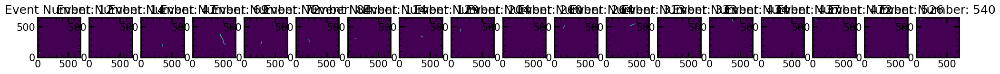

In [21]:
## Visualizar eventos rectos en una sola fila

fig, axs = plt.subplots(ncols = len(eventos_rectos), nrows=1, figsize=(25,25))
for index_event in range(0,len(eventos_rectos)):
    loc = prop[eventos_rectos[index_event]].slice
    mask_35 = np.invert(label_img==n_label)
    data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
    # plt.imshow(dataCal[maxim.start:maxim.stop])
    # ax.imshow(data_mask)

    axs[index_event].imshow(label_img == eventos_rectos[index_event])
    axs[index_event].set_title('Event Number: '+ str(eventos_rectos[index_event]))
    # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))


# plt.imshow(label_img==eventos_rectos[10])

# fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(15,15))
# round(len(eventos_rectos)/2, 0)

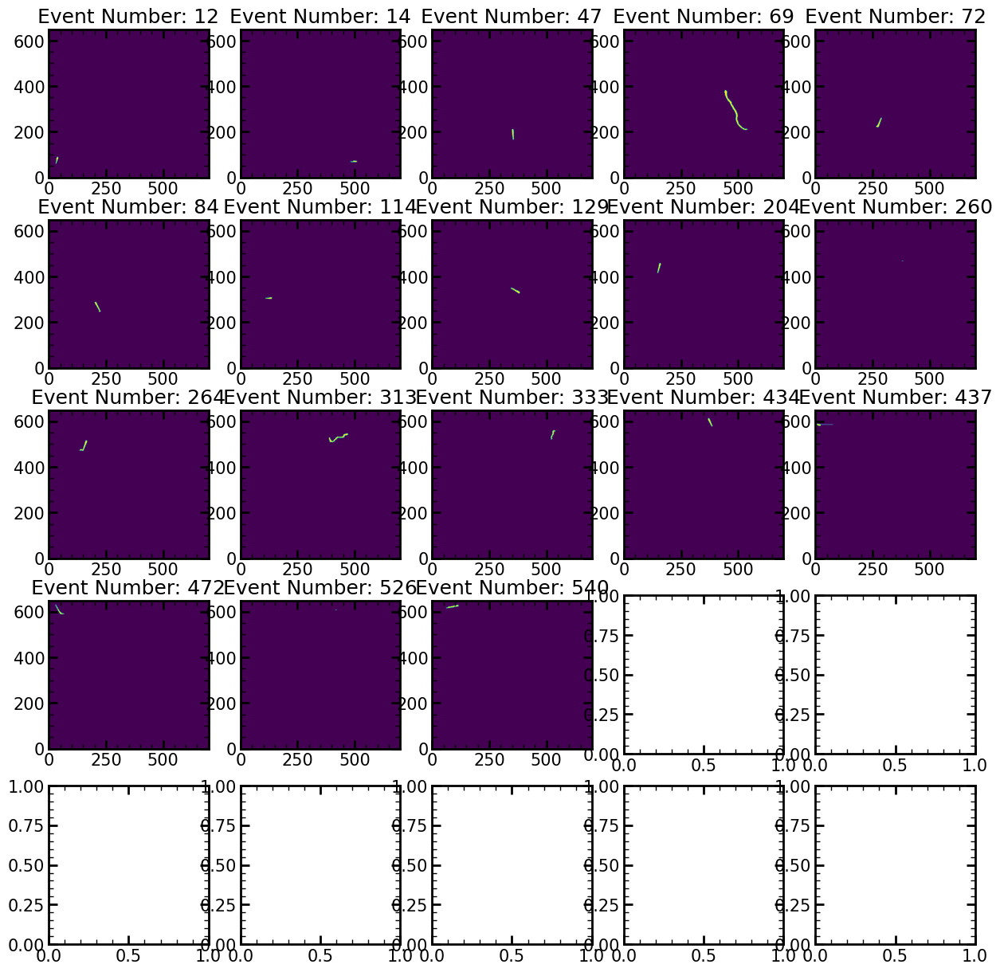

In [22]:
## Visualizar en una matriz los eventos rectos detectados 
coord2x2 = [[0,0],[0,1], [1,0], [1,1]]

coord3x3 = [[0,0],[0,1], [0,2], [1,0], [1,1], [1,2], [2,0], [2,1], [2,2]]

coord4x4 = [[0,0],[0,1], [0,2], [0,3], [1,0], [1,1], [1,2], [1,3], [2,0], [2,1], [2,2], [2,3], [3,0], [3,1], [3,2], [3,3]]

coords5x5 = [[0,0],[0,1], [0,2], [0,3], [0,4], [1,0], [1,1], [1,2], [1,3], [1,4], [2,0], [2,1], [2,2], [2,3], [2,4], [3,0], [3,1], [3,2], [3,3], [3,4],[4,0], [4,1], [4,2], [4,3], [4,4]]

if len(eventos_rectos) < 5:
    fig, axs = plt.subplots(ncols = 2, nrows = 2, figsize=(15,15))
    for index_event in range(0,len(eventos_rectos)):
        loc = prop[eventos_rectos[index_event]].slice
        mask_35 = np.invert(label_img==n_label)
        data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
        # plt.imshow(dataCal[maxim.start:maxim.stop])
        # ax.imshow(data_mask)

        axs[coord2x2[index_event][0],coord2x2[index_event][1]].imshow(label_img == eventos_rectos[index_event])
        axs[coord2x2[index_event][0],coord2x2[index_event][1]].set_title('Event Number: '+ str(eventos_rectos[index_event]))
        # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))

elif len(eventos_rectos) > 4 and len(eventos_rectos) < 10:
    fig, axs = plt.subplots(ncols = 3, nrows = 3, figsize=(15,15))
    for index_event in range(0,len(eventos_rectos)):
        loc = prop[eventos_rectos[index_event]].slice
        mask_35 = np.invert(label_img==n_label)
        data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
        # plt.imshow(dataCal[maxim.start:maxim.stop])
        # ax.imshow(data_mask)

        axs[coord3x3[index_event][0],coord3x3[index_event][1]].imshow(label_img == eventos_rectos[index_event])
        axs[coord3x3[index_event][0],coord3x3[index_event][1]].set_title('Event Number: '+ str(eventos_rectos[index_event]))
        # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))

elif len(eventos_rectos) > 9 and len(eventos_rectos) < 17:
    fig, axs = plt.subplots(ncols = 4, nrows = 4, figsize=(15,15))
    for index_event in range(0,len(eventos_rectos)):
        loc = prop[eventos_rectos[index_event]].slice
        mask_35 = np.invert(label_img==n_label)
        data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
        # plt.imshow(dataCal[maxim.start:maxim.stop])
        # ax.imshow(data_mask)

        axs[coord4x4[index_event][0],coord4x4[index_event][1]].imshow(label_img == eventos_rectos[index_event])
        axs[coord4x4[index_event][0],coord4x4[index_event][1]].set_title('Event Number: '+ str(eventos_rectos[index_event]))
        # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))

elif len(eventos_rectos) > 16 and len(eventos_rectos) < 25:
    fig, axs = plt.subplots(ncols = 5, nrows = 5, figsize=(15,15))
    for index_event in range(0,len(eventos_rectos)):
        loc = prop[eventos_rectos[index_event]].slice
        mask_35 = np.invert(label_img==n_label)
        data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
        # plt.imshow(dataCal[maxim.start:maxim.stop])
        # ax.imshow(data_mask)

        axs[coords5x5[index_event][0],coords5x5[index_event][1]].imshow(label_img == eventos_rectos[index_event])
        axs[coords5x5[index_event][0],coords5x5[index_event][1]].set_title('Event Number: '+ str(eventos_rectos[index_event]))
        # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))

elif len(eventos_rectos) > 25:
    print('Demasiados eventos para mostrar!!!')



In [ ]:
label_img, n_events = sk.measure.label(dataCal>6*popt[2], background=6*popt[2], connectivity=2, return_num=True)
label_img==0

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

# DataFrames de Muones de todas las extensiones 

In [ ]:
expgain = [227, 220.4, 94.72, 197.7]
list_labels = []
list_EventsNumber = []
list_ExensionDataFrame = []
list_EventCharge_AllExtensions = []
list_eventos_rectos_ALLExtensions = []

path = ['/home/labdet/Documents/MauSan/imagenesMicrochip/14JUN23/proc_skp_m-009_microchip_T_170__Vv82_NSAMP_1_NROW_700_NCOL_700_EXPOSURE_1200_NBINROW_1_NBINCOL_1_img_7.fits']
# path = ['/home/labdet/Documents/MauSan/imagenesMicrochip/14JUN23/proc_skp_m-009_microchip_T_170__Vv82_NSAMP_1_']

for img in path:
    hdu_list = fits.open(img)
    
    for extension in range(0,4):

        ## Lists for fill DataFrame ##
        list_Runid = []
        list_ext = []
        list_Matrix_Slice_Event = []
        list_Size_Matrix_Event = []
        list_event_size = []
        list_charge = []
        list_mean_charge = []
        list_Barycenter = []
        list_n_events = []
        list_eventos_rectos = []

        data = hdu_list[extension].data
        header=hdu_list[extension].header
        oScan=hdu_list[extension].data[638:,530:]
        nsamp=float(header['NSAMP'])
        Runid = str(header['RUNID'])

        hist , bins_edges = np.histogram(oScan.flatten(), bins = 'auto')
        offset = bins_edges[np.argmax(hist)]
        dataP = data-offset
        dataCal = dataP/expgain[extension] ## En electrones  

        bin_heights, bin_borders = np.histogram(dataCal.flatten(), bins= 'auto') 
        bin_centers=np.zeros(len(bin_heights), dtype=float)
        offset_fit = bin_borders[np.argmax(bin_heights)]
        for p in range(len(bin_heights)):
            bin_centers[p]=(bin_borders[p+1]+bin_borders[p])/2

        xmin_fit, xmax_fit = offset_fit-(10*expgain[extension-1])/math.sqrt(nsamp), offset_fit+(10*expgain[extension-1])/math.sqrt(nsamp)			# Define fit range
        bin_heights = bin_heights[(bin_centers>xmin_fit) & (bin_centers<xmax_fit)]
        bin_centers = bin_centers[(bin_centers>xmin_fit) & (bin_centers<xmax_fit)]

        popt,_ = curve_fit(gaussian, bin_centers, bin_heights)#, p0=[np.max(bin_heights), 0, 1], maxfev=100000)		# Fit histogram with gaussian

        # label, n_events =ndimage.label(dataCal>6*abs(popt[2]),structure=[[1,1,1],[1,1,1],[1,1,1]])
        label_img, n_events = sk.measure.label(dataCal>6*popt[2], background=6*popt[2], connectivity=2, return_num=True)
        prop = sk.measure.regionprops(label_img, dataCal)
        
        # print(nlabels_img)
        list_labels.append(label_img)
        list_EventsNumber.append(n_events)
        
        ## Obteniendo el valor promedio del fondo
        fondo_mask = np.invert(label_img == 0)
        fondo = ma.masked_array(dataCal,fondo_mask)
        valor_promedio_fondo = fondo.data.mean()

        for event in range(0,n_events):
            if prop[event].axis_major_length > 4.5 * prop[event].axis_minor_length:
                # list_n_events.append(event)
                list_eventos_rectos.append(event+1)

                mask = np.invert(label_img == event+1)
                loc = prop[event].slice
                # loc = ndimage.find_objects(label==i)[0]
                
                data_maskEvent = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])

                ## Número de imagen
                list_Runid.append(Runid)

                ## Número de Extensión
                list_ext.append(extension+1) ## The extension's number is 1,2,3 or 4.

                ## Lista de Coordenadas de cada evento
                list_Size_Matrix_Event.append(str(data_maskEvent.shape[1])+'x'+str(data_maskEvent.shape[0])) ## La dimensión de la matriz del evento en pixeles

                event_size = 0
                # Obtiene los pixeles que componen al evento
                for i in range(0,len(data_maskEvent.flatten())):
                    if data_maskEvent.flatten()[i]:
                        event_size = event_size+1
                list_event_size.append(int(event_size))
                # print(list_event_size)

                # Obtiene la carga total en electrones si el evento es recto 
                charge = 0
                for i in data_maskEvent.data.flatten():
                    if i >= valor_promedio_fondo:
                        charge = charge + i
                # list_charge.append(data_maskEvent.sum())
                list_charge.append(charge)
                list_EventCharge_AllExtensions.append(charge)

                # Carga promedio en electrones
                try:
                    mean_charge = charge/event_size
                    list_mean_charge.append(round(mean_charge,3))
                except:
                    list_mean_charge.append('None Event Size')
                    continue
                

                ## Barycenter
                coordX_Barycenter = round(ndimage.center_of_mass(data_maskEvent)[1],4)
                coordY_Barycenter = round(ndimage.center_of_mass(data_maskEvent)[0],4)
                list_coordBarycenter = [coordX_Barycenter,coordY_Barycenter ]
                list_Barycenter.append(list_coordBarycenter)

                RunidFrame = pd.DataFrame(list_Runid, columns = ['Image ID'])
                ExtensionFrame = pd.DataFrame(list_ext, columns = ['Extension'])
                Event_IDFrame= pd.DataFrame(list_eventos_rectos, columns = ['Event ID'])
                Matrix_Size_EventFrame = pd.DataFrame(list_Size_Matrix_Event, columns = ['Matrix Size (px)'])
                Event_SizeFrame = pd.DataFrame(list_event_size, columns = ['Event Size (px)'])
                ChargeFrame = pd.DataFrame(list_charge, columns = ['Total Charge (e-)'])
                MeanChargeFrame = pd.DataFrame(list_mean_charge, columns = ['Mean Charge (e-)'])

                totalFrame = pd.concat([Event_IDFrame,RunidFrame, ExtensionFrame, Matrix_Size_EventFrame, Event_SizeFrame, ChargeFrame, MeanChargeFrame], axis = 1 )
                totalFrame['Barycenter'] = pd.Series(list_Barycenter)
                
        list_eventos_rectos_ALLExtensions.append(list_eventos_rectos)
        list_ExensionDataFrame.append(totalFrame.set_index('Event ID'))

In [ ]:
# plt.imshow(list_labels[3]==0)
print("Eventos Detectados por Extensión: ", list_EventsNumber)
print("Eventos Rectos por Extensión: ", len(list_eventos_rectos_ALLExtensions[0]), len(list_eventos_rectos_ALLExtensions[1]), len(list_eventos_rectos_ALLExtensions[2]), len(list_eventos_rectos_ALLExtensions[3]))
print("Total de Eventos detectados en la imagen: ", sum(list_EventsNumber))
print("Total de Eventos Rectos detectados: ",len(list_eventos_rectos_ALLExtensions[0])+ len(list_eventos_rectos_ALLExtensions[1])+len(list_eventos_rectos_ALLExtensions[2])+len(list_eventos_rectos_ALLExtensions[3]))

## Muestra el DataFrame de eventos rectos seleccionando la extensión
# list_ExensionDataFrame[1]


Eventos Detectados por Extensión:  [55, 60, 0, 79]
Eventos Rectos por Extensión:  19 19 0 23
Total de Eventos detectados en la imagen:  194
Total de Eventos Rectos detectados:  61


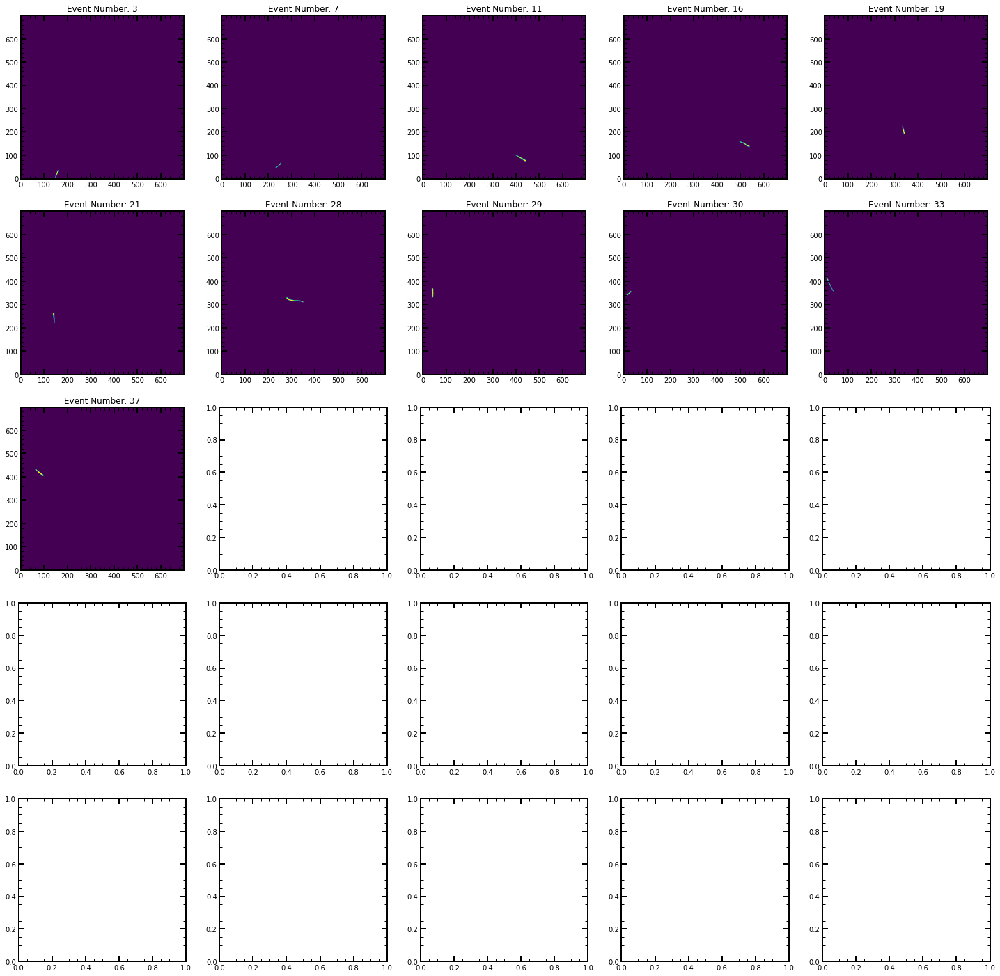

In [ ]:
fig, axs = plt.subplots(ncols = 5, nrows=5, figsize=(25,25))
coords = [[0,0],[0,1], [0,2], [0,3], [0,4], [1,0], [1,1], [1,2], [1,3], [1,4], [2,0], [2,1], [2,2], [2,3], [2,4], [3,0], [3,1], [3,2], [3,3], [3,4],
          [4,0], [4,1], [4,2], [4,3], [4,4]]
for index_event in range(0,len(list_eventos_rectos_ALLExtensions[0])):
    # loc = prop[list_eventos_rectos_ALLExtensions[0][index_event]].slice
    # mask_35 = np.invert(label_img == n_label)
    # data_mask = ma.masked_array(dataCal[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop], mask_35[loc[0].start:loc[0].stop, loc[1].start:loc[1].stop])
    # plt.imshow(dataCal[maxim.start:maxim.stop])
    # ax.imshow(data_mask)

    axs[coords[index_event][0],coords[index_event][1]].imshow(list_labels[0] == list_eventos_rectos_ALLExtensions[0][index_event])
    axs[coords[index_event][0],coords[index_event][1]].set_title('Event Number: '+ str(list_eventos_rectos_ALLExtensions[0][index_event]))
    # axs[0, index_event].axis((loc[1].start-ext, loc[1].stop+ext, loc[0].start-ext, loc[0].stop+ext))

(array([10.,  0.,  0.,  2.,  5.,  7.,  5.,  2.,  2.,  1.,  1.,  0.,  0.,
         0.,  1.,  1.,  3.,  2.,  2.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([7.04185638e+01, 8.45369979e+03, 1.68369810e+04, 2.52202622e+04,
        3.36035435e+04, 4.19868247e+04, 5.03701059e+04, 5.87533871e+04,
        6.71366684e+04, 7.55199496e+04, 8.39032308e+04, 9.22865120e+04,
        1.00669793e+05, 1.09053074e+05, 1.17436356e+05, 1.25819637e+05,
        1.34202918e+05, 1.42586199e+05, 1.50969481e+05, 1.59352762e+05,
        1.67736043e+05, 1.76119324e+05, 1.84502606e+05, 1.92885887e+05,
        2.01269168e+05, 2.09652449e+05, 2.18035730e+05, 2.26419012e+05,
        2.34802293e+05, 2.43185574e+05, 2.51568855e+05, 2.59952137e+05,
        2.68335418e+05, 2.76718699e+05, 2.85101980e+05, 2.93485261e+05,
        3.

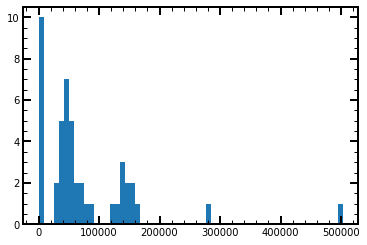

In [ ]:
# hist, bins = np.histogram(list_EventCharge_AllExtensions)
# print(hist)
# print(bins[1:])
# poptimo,_ = curve_fit(EnergySpectrum,bins[1:], hist )
# print(poptimo)

# # x = np.arange(0, 200000)
# y = []
# for i in bins[1:]:
#     s = EnergySpectrum(i, poptimo[0])
#     y.append(s)

plt.hist(list_EventCharge_AllExtensions, bins=60)   
# plt.plot(hist,y) 
# plt.xlim(-10000,150000)


# Prueba con 'skimage.measure.regionprops_table'

In [ ]:
n_label= 3

label_img, nlabels_img = sk.measure.label(dataCal>6*popt[2], background=6*popt[2], connectivity=2, return_num=True)
print('Events: ', nlabels_img)
print('Eventos Rectos: ', eventos_rectos)
plt.imshow(label_img==n_label) # Matriz centrada en el origen

prop = sk.measure.regionprops_table(label_img,dataCal, properties=['label', 'axis_major_length', 'axis_minor_length', 'eccentricity', 'euler_number', 'centroid', 'feret_diameter_max'])

DataProp = pd.DataFrame(prop)
DataProp.set_index('label')

AttributeError: module 'skimage.measure' has no attribute 'measure'

# Getting only the High Energy Events

In [ ]:
def sum_intensity(region, intensities):
    return np.sum(intensities[region])

rps=sk.regionprops(label,intensity_image=data[0],cache=False, extra_properties=[sum_intensity])
areas=[r.area for r in rps]
energy=[r.sum_intensity for r in rps]
centr=[r.weighted_centroid for r in rps]
ecce=[r.eccentricity for r in rps]
dic_props={"areas":areas,"energias":energy,'centroid':centr, "excentricidade":ecce}

ValueError: Label and intensity image shapes must match, except for channel (last) axis.

In [ ]:
import skimage as ski
ski.__version__

'0.18.3'

In [ ]:
df=pd.DataFrame.from_dict(dic_props)
df.index = np.arange(1, len(df)+1)
# df.head(35) #show dataframe

In [ ]:
energias=dic_props["energias"]
exce=dic_props["excentricidade"]
hee_list=np.where((np.array(energias)>80) & (np.array(exce)!=1))[0].tolist() #index od the dictionary of events ---> TRESHOLD OF 80 ELECTRONS TO BE HE

In [ ]:
areas=dic_props["areas"]
see_list=np.where((np.array(exce)==1) & (np.array(areas)>9))[0].tolist() 
see_list

[]

In [ ]:
label

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

Getting there positions

In [ ]:
HE_events=np.zeros_like(label)
for event in hee_list:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        HE_events[x[i],y[i]]=1

In [ ]:
SRE_events=np.zeros_like(label)
for event in see_list:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        SRE_events[x[i],y[i]]=1

TypeError: Invalid shape (700,) for image data

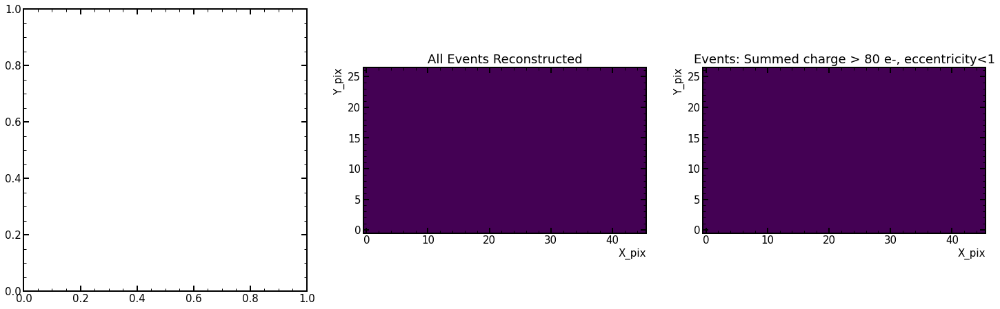

In [ ]:
fig=plt.figure(figsize=(25,15))
plt.subplot(133)
plt.imshow(HE_events)
plt.title('Events: Summed charge > 80 e-, eccentricity<1')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
# plt.colorbar()
plt.subplot(132)
plt.title('All Events Reconstructed')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.imshow(label!= 0)
plt.subplot(131)
plt.imshow(data[0],vmin=-1,vmax=1)
plt.title('Original Image')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
# plt.savefig('IMAGES_RECOHE.png', bbox_inches='tight', dpi=100)

plt.show()

In [ ]:
mask_bleeding=ndimage.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,1],[0,0,0]],
                                             iterations=40)*1.0#-(HE_events>0)*1.0

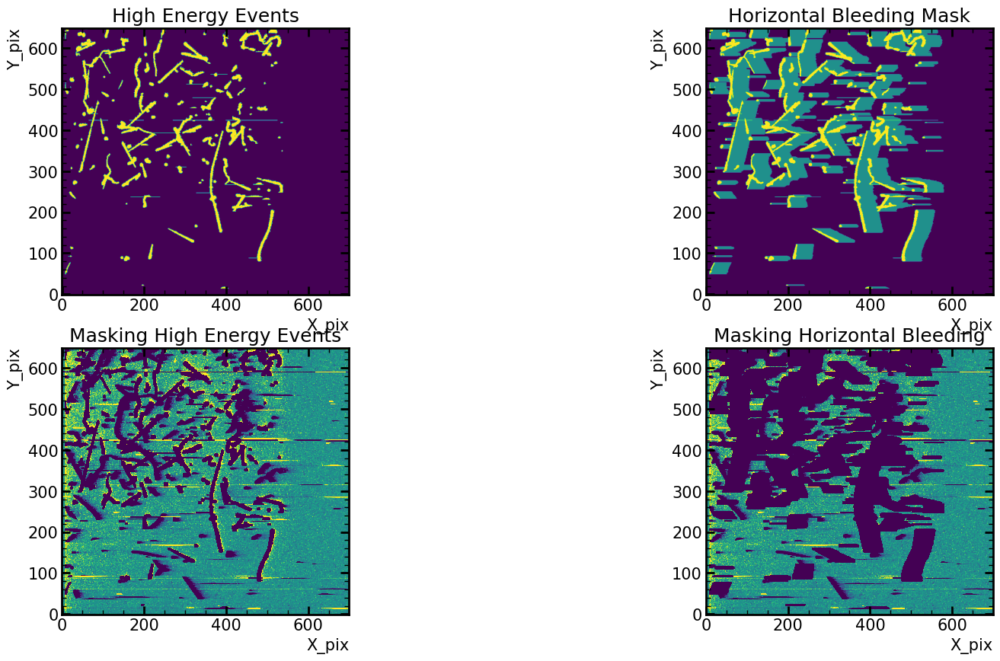

In [ ]:
plt.figure(figsize=(20,10))
# plt.subplot(223)
# plt.imshow(data[0],vmin=-1,vmax=1)
# plt.title('Original Image')
plt.subplot(221)
plt.imshow(HE_events)
plt.title('High Energy Events')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(222)
plt.imshow(mask_bleeding+(HE_events>0)*1)
plt.title('Horizontal Bleeding Mask')

plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(223)
plt.imshow(data[0]+((HE_events>0))*-1e7,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')

# plt.colorbar()
plt.title('Masking High Energy Events')
plt.subplot(224)
plt.imshow(data[0]+((mask_bleeding+HE_events>0))*-1e7,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')

plt.title('Masking Horizontal Bleeding')
#plt.savefig('IMAGES_HBLEED.png', bbox_inches='tight', dpi=100)

plt.show()

In [ ]:
maskV_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,0],[0,1,0]],
                                             iterations=20)*1.0#-(HE_events>0)*1.0

/tmp/ipykernel_19252/684858339.py:1: DeprecationWarning: Please use `binary_dilation` from the `scipy.ndimage` namespace, the `scipy.ndimage.morphology` namespace is deprecated.
  maskV_bleeding=ndimage.morphology.binary_dilation(HE_events>0,structure=[[0,0,0],[0,1,0],[0,1,0]],


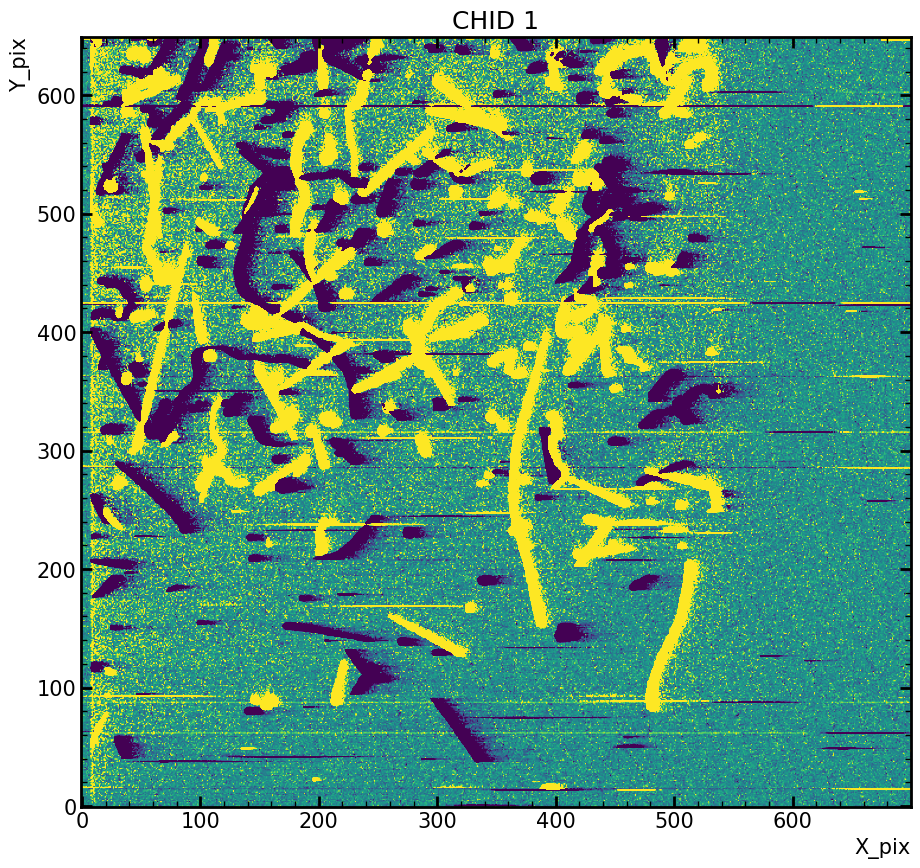

In [ ]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[0],vmin=-1,vmax=1)
plt.title('CHID 1')
# plt.savefig('IMAGES_chid1.png', bbox_inches='tight', dpi=100)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.show()

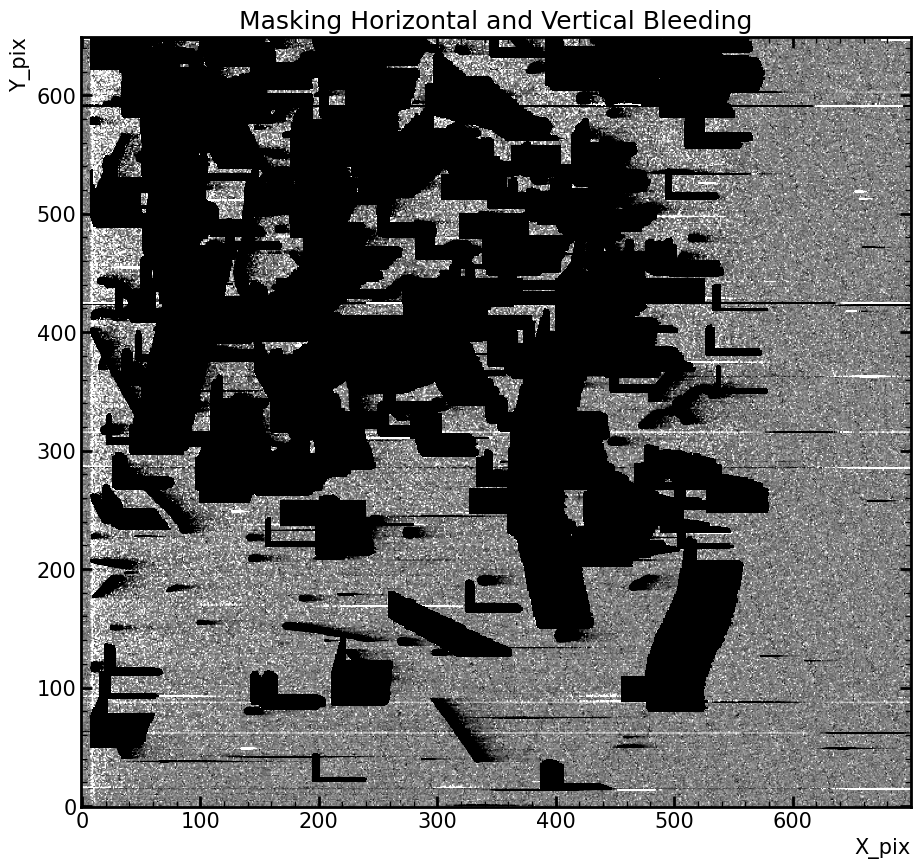

In [ ]:
fig=plt.figure(figsize=(15,10))
# plt.imshow(data[0]+((maskV_bleeding+mask_bleeding+HE_events>0))*-1e7,vmin=-1,vmax=1, cmap='gray')
plt.imshow(data[0]+((maskV_bleeding+mask_bleeding+HE_events>0))*-1e7,vmin=-1,vmax=1, cmap='gray')
plt.title('Masking Horizontal and Vertical Bleeding')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')

#plt.savefig('IMAGES_BLEED.png', bbox_inches='tight', dpi=100)

plt.show()

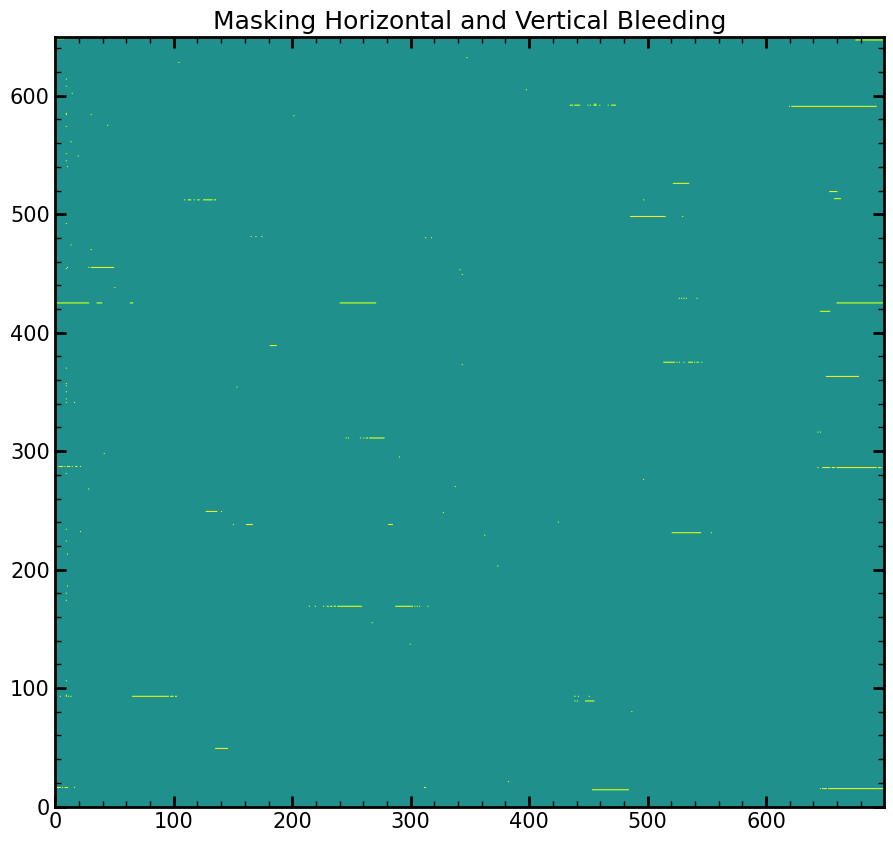

In [ ]:
plt.figure(figsize=(15,10))
plt.imshow((data[0]+((maskV_bleeding+mask_bleeding+HE_events>0))*-1e7)>4,vmin=-1,vmax=1)
plt.title('Masking Horizontal and Vertical Bleeding')
plt.show()

In [ ]:
matriz2, dmask=no_sr(data[0]+((maskV_bleeding+mask_bleeding+HE_events))*-1e7,threshold=3,trem=20)

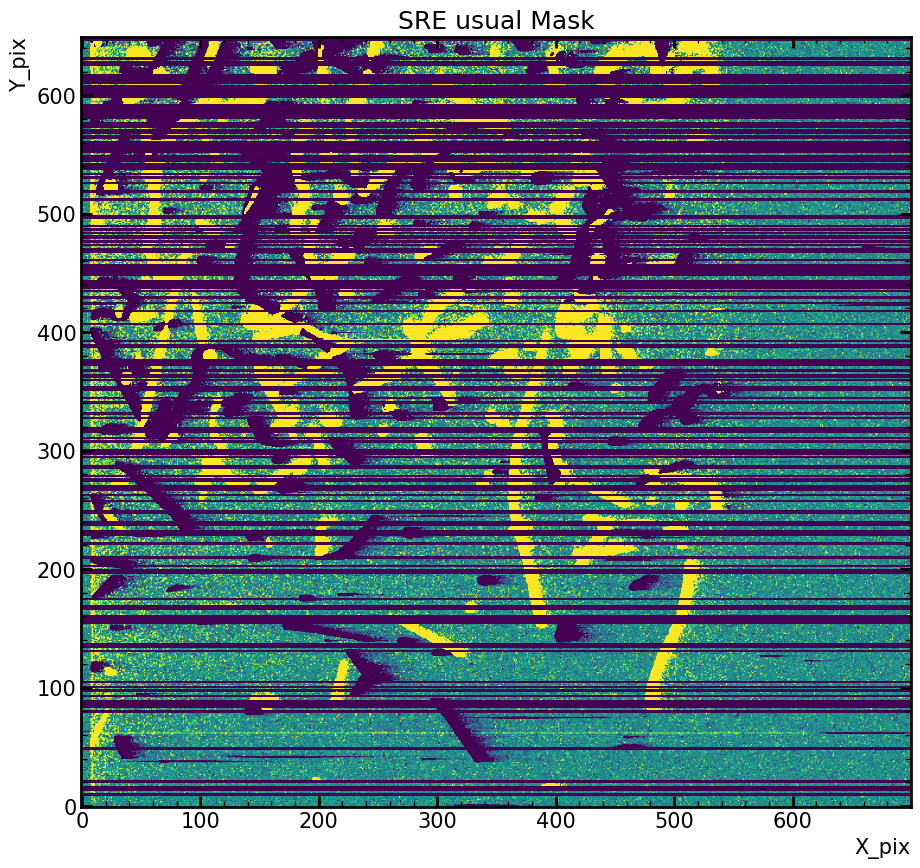

In [ ]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[0]-dmask*1e7,vmin=-1,vmax=1)
plt.title('SRE usual Mask')
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
#plt.savefig('IMAGES_SRE_std.png', bbox_inches='tight', dpi=100)
plt.show()

In [ ]:
pre_sre=ndimage.label((data[0]+((maskV_bleeding+mask_bleeding+HE_events))*-1e7)>1.5,structure=[[0,0,0],[1,1,1],[0,0,0]])[0]

In [ ]:
rps=sk.regionprops(pre_sre,cache=False)
areas=[r.area for r in rps]

SRE_events=np.zeros_like(pre_sre)
for event in np.where(np.array(areas)>1)[0].tolist():
    [x,y]=np.where(pre_sre==event+1)
    for i in range(len(x)):
        SRE_events[x[i],y[i]]=1

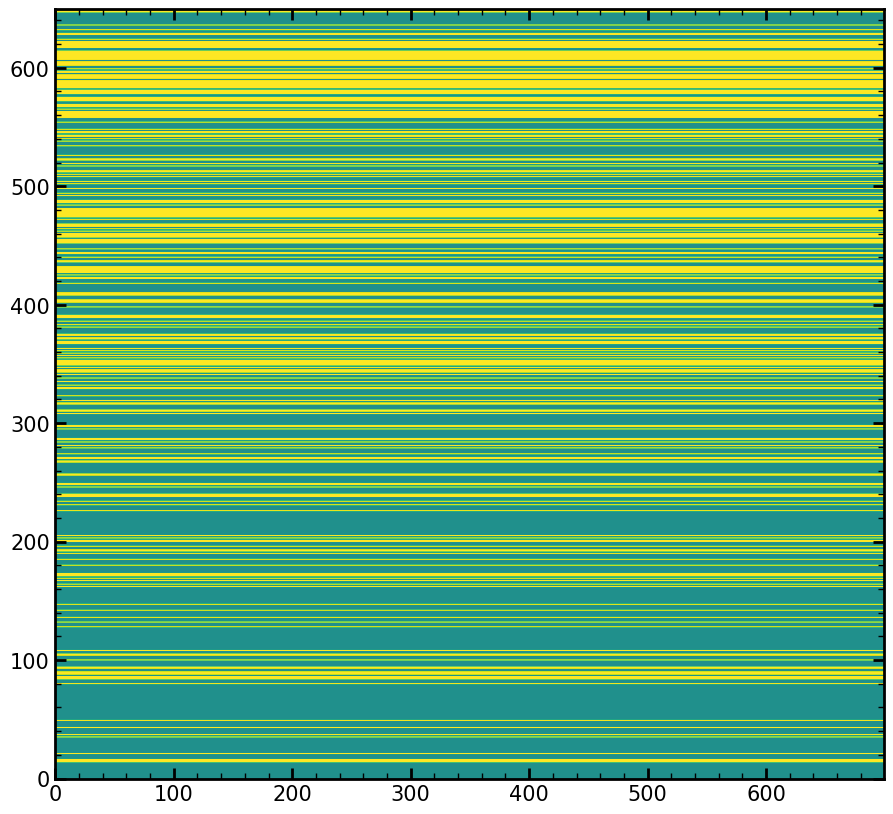

In [ ]:
SRE_mask=np.zeros_like(SRE_events)
for y in np.unique(np.where(SRE_events==1)[0]).tolist(): SRE_mask[y,:]=1
plt.figure(figsize=(15,10))
plt.imshow(SRE_mask,vmin=-1,vmax=1)
plt.show()

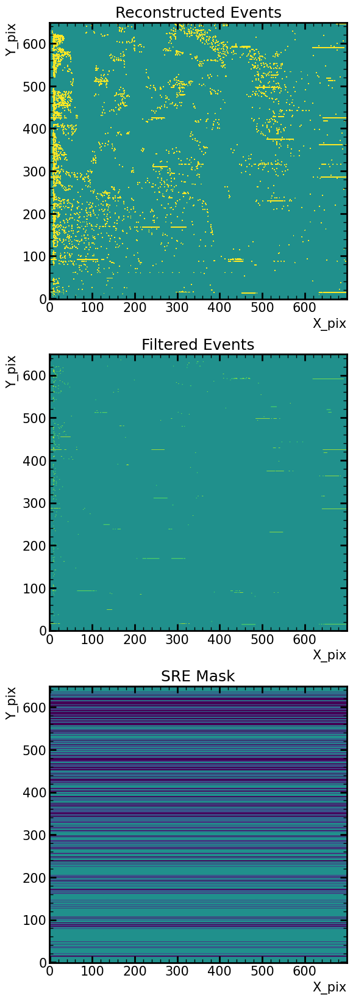

In [ ]:
plt.figure(figsize=(25,20))
plt.subplot(311)
plt.imshow(pre_sre,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('Reconstructed Events')
plt.subplot(312)
plt.imshow(SRE_events,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('Filtered Events')
plt.subplot(313)
plt.imshow(-SRE_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE Mask')
# plt.savefig('IMAGES_SRE_pre.png', bbox_inches='tight', dpi=100)

plt.show()

In [ ]:
np.unique(np.where(SRE_events==1)[0])

array([ 14,  15,  16,  21,  35,  37,  43,  49,  80,  84,  85,  86,  88,
        89,  90,  93,  94, 100, 104, 105, 108, 128, 132, 136, 142, 147,
       162, 164, 167, 169, 171, 172, 173, 180, 185, 190, 192, 193, 196,
       200, 201, 203, 205, 226, 231, 234, 238, 239, 240, 246, 248, 249,
       256, 257, 267, 268, 270, 271, 274, 279, 281, 284, 286, 287, 295,
       297, 298, 308, 310, 311, 316, 317, 319, 323, 329, 330, 332, 335,
       338, 341, 343, 344, 345, 347, 349, 350, 351, 352, 353, 355, 357,
       359, 361, 363, 367, 368, 369, 371, 372, 374, 375, 381, 383, 386,
       389, 390, 391, 398, 402, 403, 404, 408, 409, 410, 418, 422, 423,
       425, 427, 428, 429, 430, 431, 432, 436, 437, 440, 443, 444, 447,
       452, 453, 454, 455, 457, 458, 459, 460, 462, 464, 466, 467, 468,
       472, 474, 475, 476, 477, 478, 479, 480, 481, 484, 486, 487, 488,
       492, 494, 498, 502, 504, 508, 510, 512, 513, 517, 519, 522, 523,
       526, 534, 538, 540, 542, 543, 545, 546, 548, 554, 558, 55

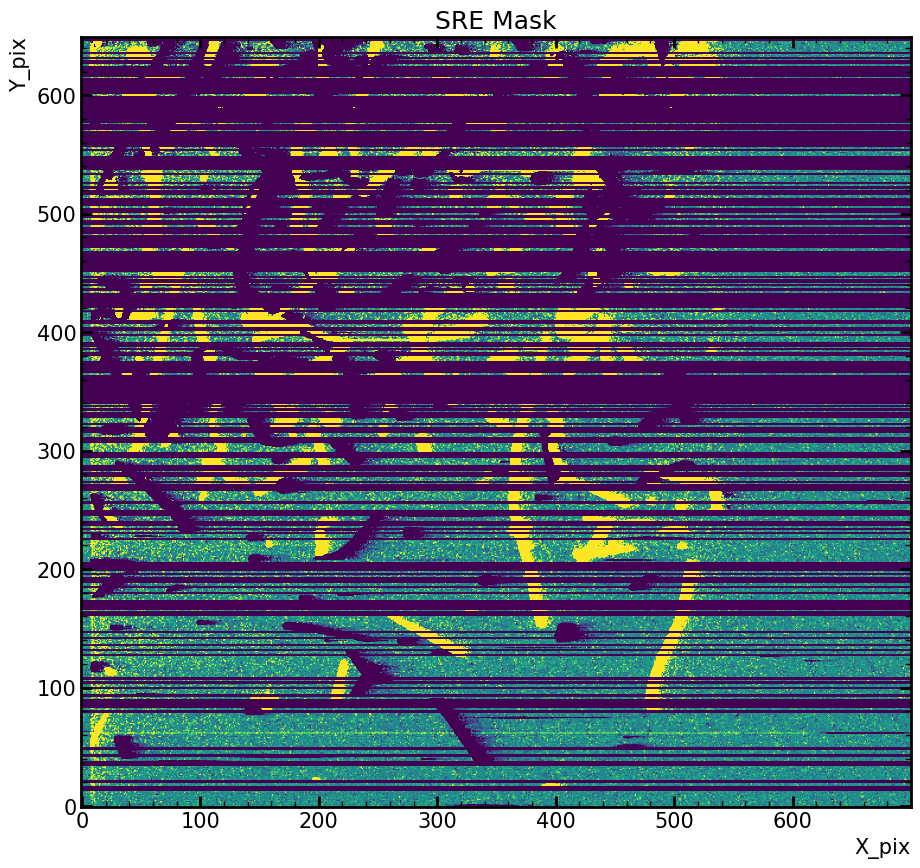

In [ ]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[0]-1e7*SRE_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE Mask')
#plt.savefig('IMAGES_SRE_MASK.png', bbox_inches='tight', dpi=100)
plt.show()

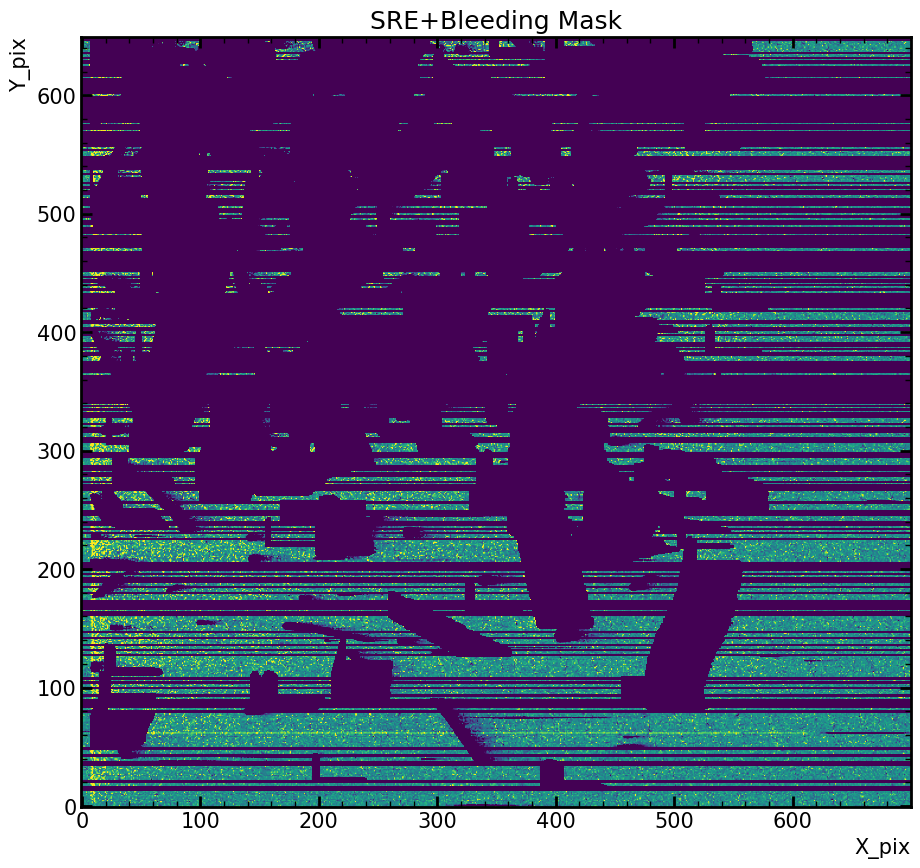

In [ ]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[0]-1e7*(maskV_bleeding+mask_bleeding+SRE_mask),vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE+Bleeding Mask')

#plt.savefig('IMAGES_TOTALMASK.png', bbox_inches='tight', dpi=100)
plt.show()

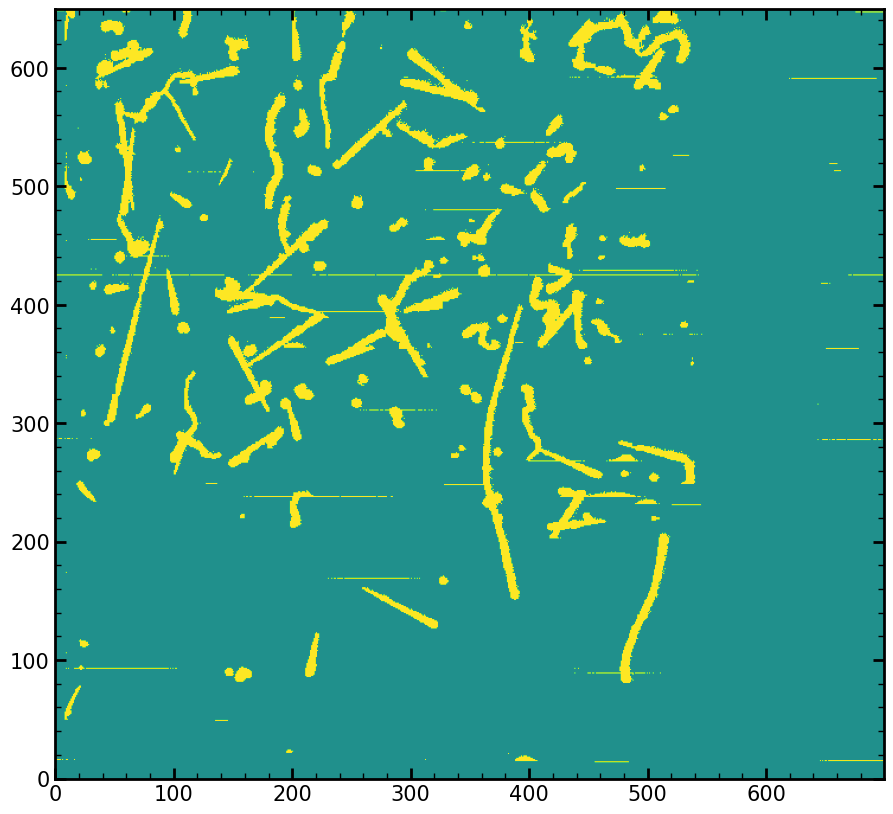

In [ ]:
plt.figure(figsize=(15,10))
plt.imshow(label!=0,vmin=-1,vmax=1)
plt.show()

In [ ]:
def sum_intensity(region, intensities):
    return np.sum(intensities[region])

rps=sk.regionprops(label,intensity_image=data[1],cache=False, extra_properties=[sum_intensity])
areas=[r.area for r in rps]
energy=[r.sum_intensity for r in rps]
centr=[r.weighted_centroid for r in rps]
ecce=[r.eccentricity for r in rps]
dic_props={"areas":areas,"energias":energy,'centroid':centr, "excentricidade":ecce}

In [ ]:
flag0=[]
for i in range(len(centr)):
    if int(centr[i][0]) not in np.unique(np.where(SRE_events==1)[0]).tolist():
        
        flag0.append(i)

In [ ]:
flag0_events=np.zeros_like(label)
for event in flag0:
    [x,y]=np.where(label==event+1)
    for i in range(len(x)):
        flag0_events[x[i],y[i]]=1

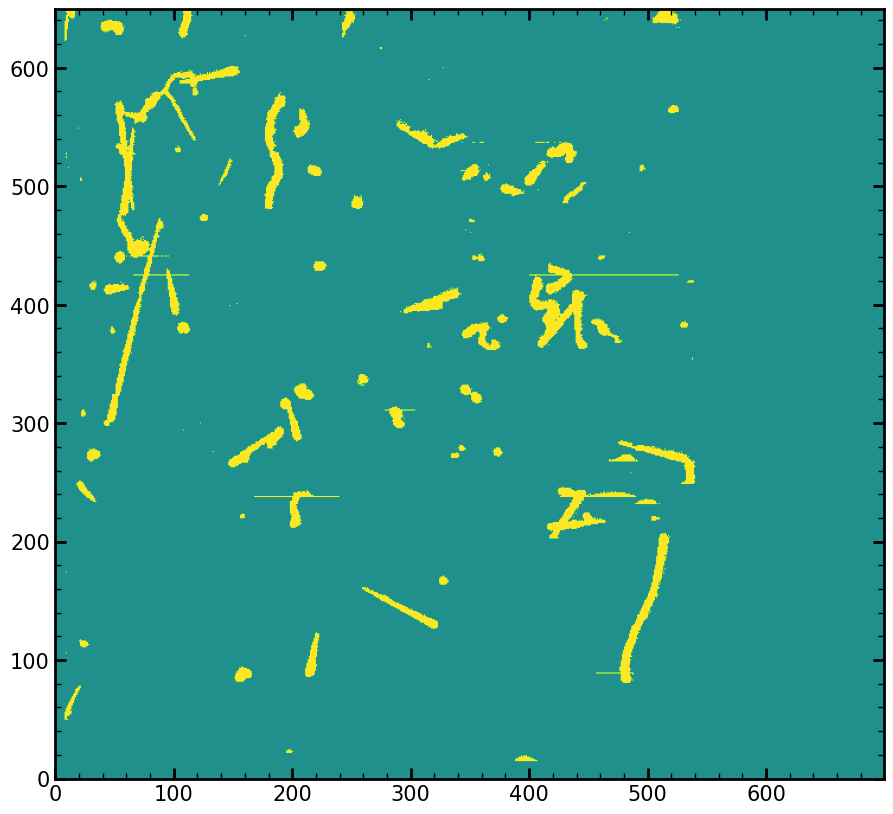

In [ ]:
plt.figure(figsize=(15,10))
plt.imshow(flag0_events,vmin=-1,vmax=1)
plt.show()

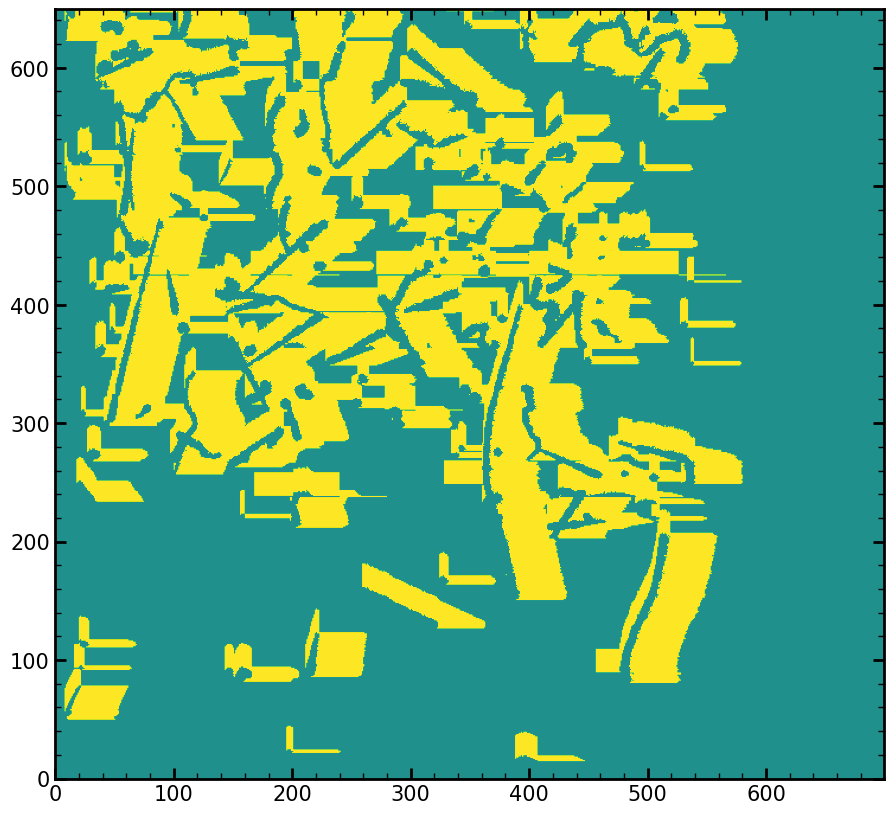

In [ ]:
plt.figure(figsize=(15,10))
plt.imshow(maskV_bleeding+mask_bleeding-2*HE_events,vmin=-1,vmax=1)
plt.show()

In [ ]:
type(centr[0] )

tuple

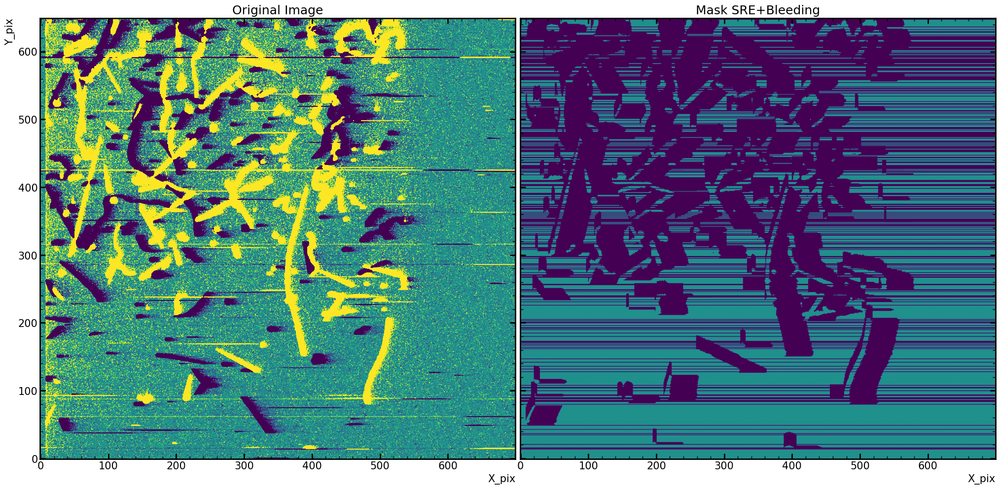

In [ ]:
fig=plt.figure(figsize=(25,15))
plt.subplot(121)
plt.title('Original Image')
plt.imshow(data[0],vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.subplot(122)
plt.imshow(-(maskV_bleeding+mask_bleeding-2*HE_events+SRE_mask),vmin=-1,vmax=1)
plt.title('Mask SRE+Bleeding')
plt.tick_params('y', labelleft=False)
plt.subplots_adjust(wspace=0.01)
plt.xlabel('X_pix')
#plt.savefig('Imageandmask.png', bbox_inches='tight', dpi=100)
plt.show()

# SINGLE ELECTRON RATE

In [ ]:
event_mask=maskV_bleeding+mask_bleeding
event_halo_mask = ndimage.binary_dilation(
        event_mask>0,
        iterations = 10,
        structure = ndimage.generate_binary_structure(rank=2, connectivity=2) # == [[1,1,1],[1,1,1],[1,1,1]]
    )
event_halo_SR_mask = np.array(SRE_mask,dtype=bool)|event_halo_mask

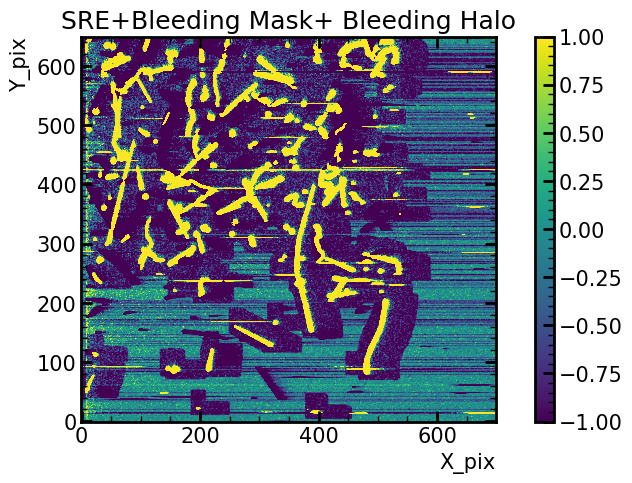

In [ ]:
fig=plt.figure(figsize=(10,5))
plt.imshow(data[0]-event_halo_SR_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE+Bleeding Mask+ Bleeding Halo')
#plt.savefig('SER.png', bbox_inches='tight', dpi=100)
plt.colorbar()
plt.show()

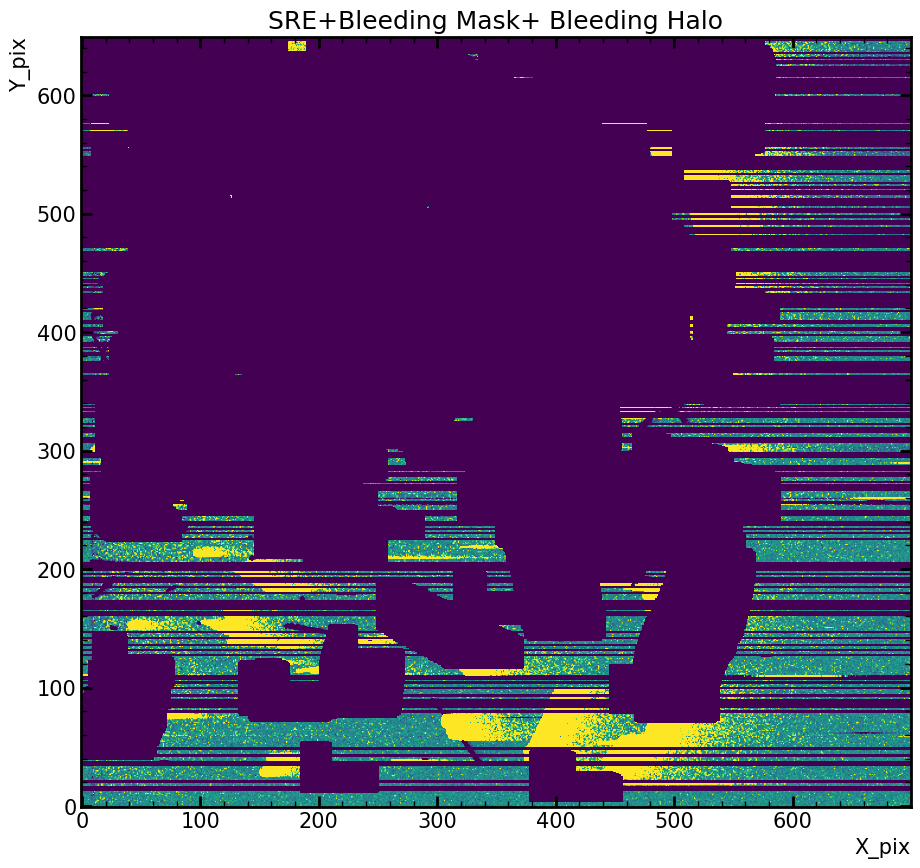

In [ ]:
fig=plt.figure(figsize=(15,10))
plt.imshow(data[1]-1e7*event_halo_SR_mask,vmin=-1,vmax=1)
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.title('SRE+Bleeding Mask+ Bleeding Halo')
plt.savefig('SER.png', bbox_inches='tight', dpi=100)
plt.show()

#### Convolution Mask is a slice of the size of the entire CCD. subtract the first and last 5 rows on vertical; and subtract the first 5 and last 5 plus overscan region
#### Masking process is using np.where, replacing the masked pixels by np.nan value
#### Making histogram

In [ ]:
convolution_mask = np.s_[5:int(hdu_list[1].header["CCDNROW"])-5, 15:-(osc+5)] #Means active area of entire CCD (slice(5, 1273, None), slice(15, -168, None)); if the slice is bigger it ok, there is no prob
masked_data = np.where(event_halo_SR_mask , np.nan, data[1] ) #aplying the mask to the data
masked_hist, bins = np.histogram( masked_data[convolution_mask], np.arange(-0.5, 2.5, .01) )
x = (bins[1:]+bins[:-1])/2 #get a mean value of the data and reshape, to adjust the size of the bins in histogram

In [ ]:
sigma_list, sigma_errLlist=LocalSigma(data,extensions=4)
global sigma
sigmaN=sigma_list[1]
def poisson_normN(x, mu, A, lamb, Nmax=5): #sigma parameter global 
    y = 0.
    for i in range(0, Nmax+1):
        y += (lamb**i)/float(math.factorial(i)) *np.exp(-0.5*((x-i-mu-lamb)/float(sigmaN))**2)
    return A*np.exp(-lamb)*y/(np.sqrt(2*np.pi*sigmaN**2))

In [ ]:

try:
    popt, pcov = curve_fit( 
        poisson_normN, 
        x, 
        masked_hist, 
        p0=[-0.4, 1000, 0.05],
    )
except (RuntimeError,OptimizeWarning,RuntimeWarning):
    print( f"Error - dc fit failed at" )

In [ ]:
print(popt)
chid=1
start=parse(hdu_list[chid].header["DATESTART"]+"Z").timestamp()
end=parse(hdu_list[chid].header["DATEEND"]+"Z").timestamp()
time=datetime.timedelta(seconds=end-start)
readout_time=time.total_seconds()/86400 #readout time in days

exposure_time=readout_time*int(hdu_list[chid].header["CCDNROW"])/(2*int(hdu_list[chid].header["NROW"]))
print(exposure_time)
perr = np.sqrt(np.diag(pcov))
dc = popt[2]/exposure_time # electron/pix/day
dc_err = perr[2]/exposure_time # electron/pix/day
print(dc,dc_err)

[-2.39241201e-01  5.11075359e+02  1.89626284e-01]
0.08326570512820514
2.2773635745761336 0.06709086956055965


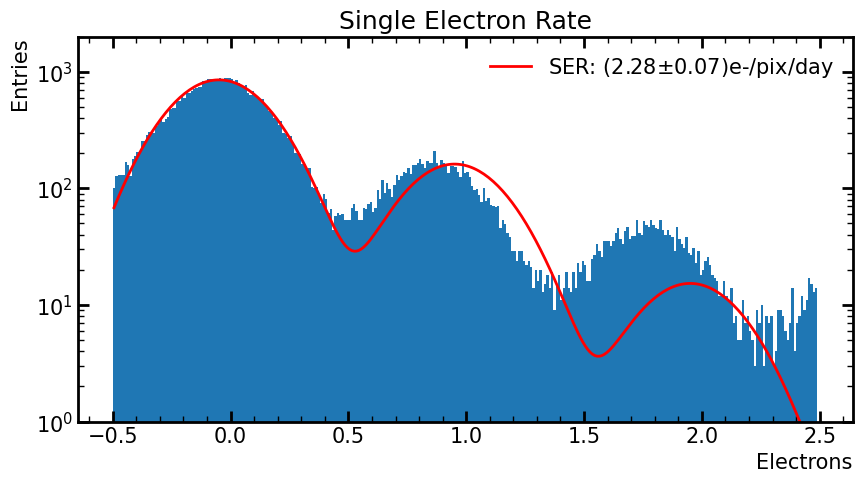

In [ ]:
fig=plt.figure(figsize=(10,5))
plt.bar(x,masked_hist,width=0.01)
plt.plot(x,poisson_normN(x,*popt),linewidth=2,c='r',label=r'SER: ({:.2f}$\pm${:.2f})e-/pix/day'.format(dc,dc_err))
plt.yscale('log')
plt.ylim(1,2e3)
plt.ylabel('Entries')
plt.xlabel('Electrons')
plt.title('Single Electron Rate')
plt.legend()
#plt.savefig('SER_HISTO.png', bbox_inches='tight', dpi=100)

plt.show()

## Spurious Charge

2.032777777777778
7318
6796.0738065934065


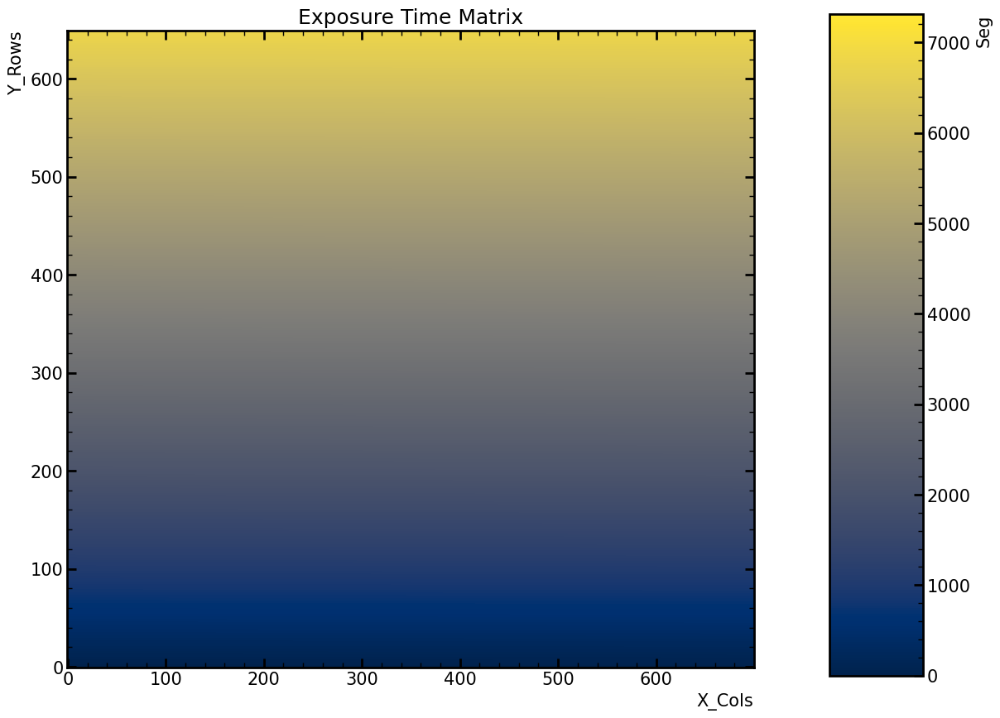

In [ ]:
ExpoMatrix, Ttot, NRow, NCol, NSamp= totTime(path)
fig=plt.figure(figsize=(15,10))
plt.subplot(1,1,1)

cmap = mpl.cm.cividis

#plt.imshow(ExpoMatrix,cmap=cmap,vmin=0,vmax=Ttot/3600) #Horas
plt.imshow(ExpoMatrix,cmap=cmap, vmin=0,vmax=Ttot) #Segundos

plt.title('Exposure Time Matrix')
plt.ylabel('Y_Rows')
plt.xlabel('X_Cols')

cax = plt.axes([0.85, 0.1, 0.075, 0.8])
plt.colorbar(cax=cax)
plt.ylabel('Seg')


# ExpoMatrix
print(Ttot/60/60)
print(Ttot)

print(ExpoMatrix.max())

HEF=0.01608351648352104 VEF=10.454285714285717


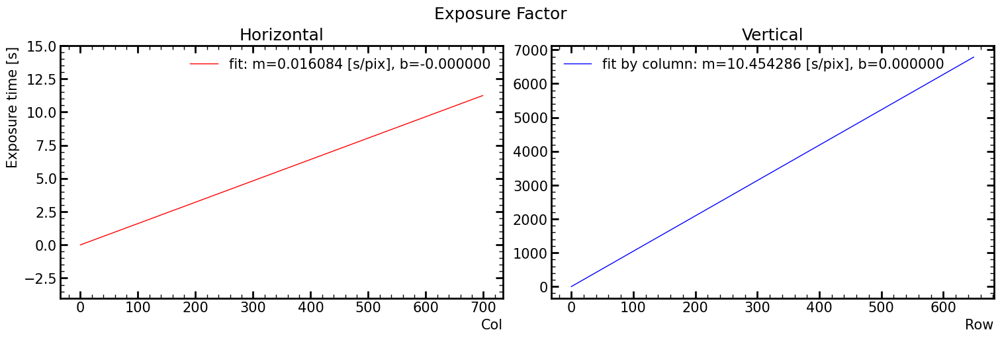

In [ ]:
HEF, VEF = exposureFactor(path) #Exposure Factor in [s/pix]

fig_all, axs_all = plt.subplots(nrows=1, ncols=2, figsize=(15, 5),constrained_layout=True)		# Create figures
fig_all.suptitle('Exposure Factor', fontsize='large')
axs_all[0].set_title('Horizontal')
axs_all[0].set_ylim([-4, 15])
axs_all[0].set_ylabel('Exposure time [s]')
axs_all[0].set_xlabel('Col')
axs_all[1].set_xlabel('Row')
axs_all[0].plot(range(0,len(ExpoMatrix[0])), line(range(0,len(ExpoMatrix[0])), HEF[0], HEF[1]),'r-', label='fit: m=%f [s/pix], b=%f' % tuple(HEF))


axs_all[0].legend()

axs_all[1].set_title('Vertical')
axs_all[1].plot(range(0,len(ExpoMatrix[:,0])), line(range(0,len(ExpoMatrix[:,0])), VEF[0], VEF[1]),'b-', label='fit by column: m=%f [s/pix], b=%f' % tuple(VEF))
axs_all[1].legend()
plt.show()

media on Row=-0.02007209824288352, stdDev on y=0.8323680534514376
Check
media on Col=0.005640947607287841, stdDev on y=0.09329060641788116


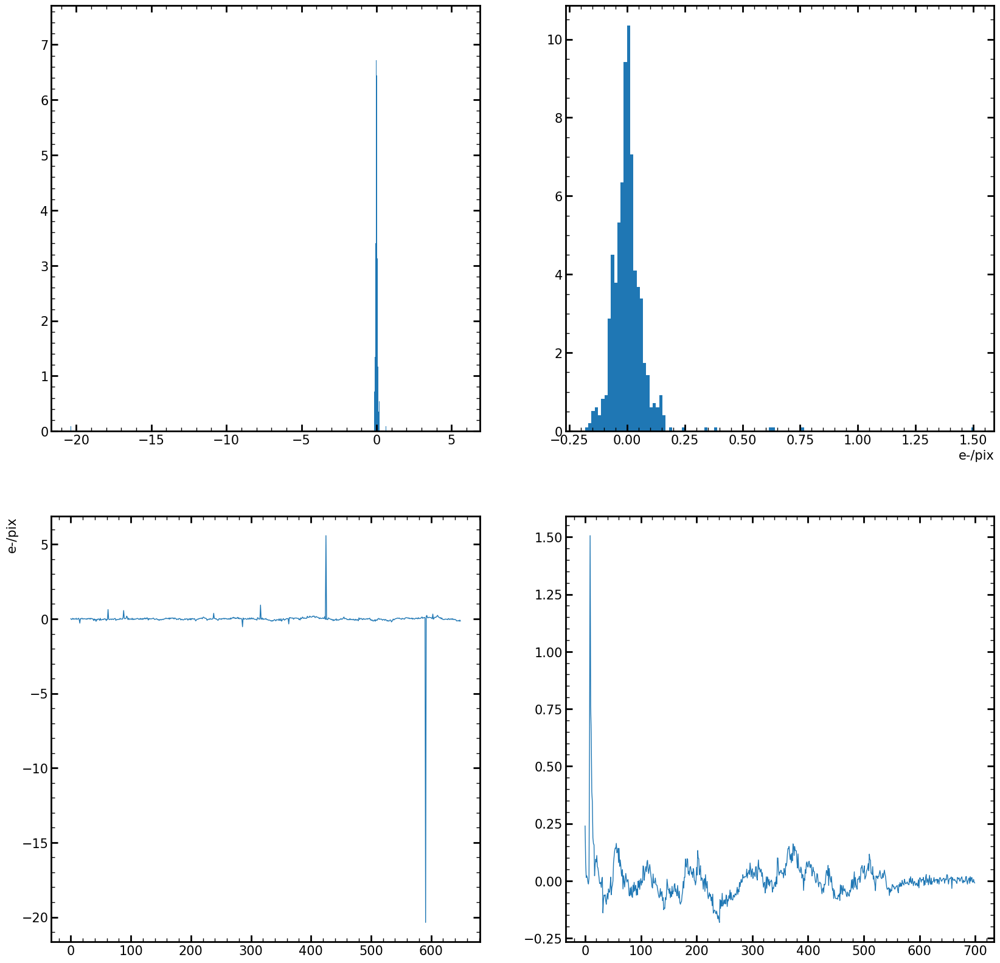

In [ ]:

data_masked=data[0]#-1e7*(maskV_bleeding+mask_bleeding+SRE_mask)
data_Row, data_Col, Row_bins, Col_bins, Row_hist, Col_hist = hist_RowColumn(data_masked)

fig_all, axs_all = plt.subplots(2, 2, figsize=(20, 20))		# Create figures


axs_all[0][0].hist(data_Row, Row_bins, density=True)

axs_all[0][1].hist(data_Col, Col_bins, density=True)

axs_all[1][0].plot(data_Row)

axs_all[1][1].plot(data_Col)

axs_all[1][0].set_ylabel('e-/pix')
axs_all[0][1].set_xlabel('e-/pix')

plt.show()


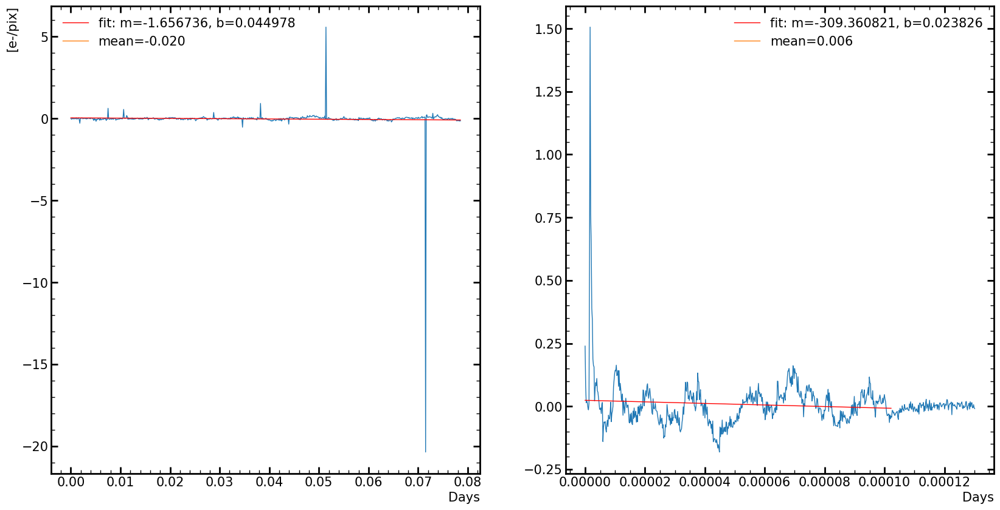

In [ ]:
#NROW650_NCOL700
fig_all, axs_all = plt.subplots(1, 2, figsize=(20, 10))		# Create figures
x_data=[]
i=0

for value in data_Row:  
            x_data.append(i)
            i+=1
Xdata=np.array(x_data)*VEF[0]/86400

axs_all[0].plot(Xdata, data_Row) #Xdata[Pix]*VEF[S/Pix], data_Row[e-]*86400[s/day]/VEF[s/pix]
popt, pcov = curve_fit(line, Xdata, data_Row)
axs_all[0].plot(Xdata, line(Xdata, popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
rowValues=popt
axs_all[0].plot(np.mean(data_Row), label="mean=%5.3f" % np.mean(data_Row) )
axs_all[0].set_ylabel('[e-/pix]')
axs_all[0].set_xlabel('Days')
axs_all[0].legend()

x_data=[]
i=0

for value in data_Col:  
            x_data.append(i)
            i+=1
Xdata=np.array(x_data)*HEF[0]/86400

axs_all[1].plot(Xdata, data_Col)
popt, pcov = curve_fit(line, Xdata[:550], data_Col[:550])
axs_all[1].plot(Xdata[:550], line(Xdata[:550], popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
colValues=popt
axs_all[1].plot(np.mean(data_Col[:550]), label="mean=%5.3f" % np.mean(data_Col) )
axs_all[1].set_xlabel('Days')
axs_all[1].legend()

## TO DO: Enmascarar los datos


In [ ]:
ma.masked_array(data[0], mask=event_halo_mask)

masked_array(
  data=[[-25.047197030618605, -5.366232009747293, -0.40893894245964735,
         ..., -0.09793436257313082, 0.939482242970455,
         -0.21025424098206683],
        [0.26101504074041715, 0.053421324682748524, -0.24067616252569915,
         ..., 0.09097341784738361, -0.3018052622035696,
         -0.4623490607312288],
        [0.24572630988905292, 0.37082204747281033, 0.29557911051382363,
         ..., -0.04144788445444376, 0.4255920307496824,
         0.16297428492909427],
        ...,
        [--, --, --, ..., 2066.6520418674836, 2539.2420817957895,
         2633.264727366008],
        [--, --, --, ..., 0.3161538008181172, -0.025635591136505532,
         -0.03839991307910231],
        [--, --, --, ..., -0.24861645363898663, -0.2031591419984963,
         -0.13980262259829423]],
  mask=[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [ Tr

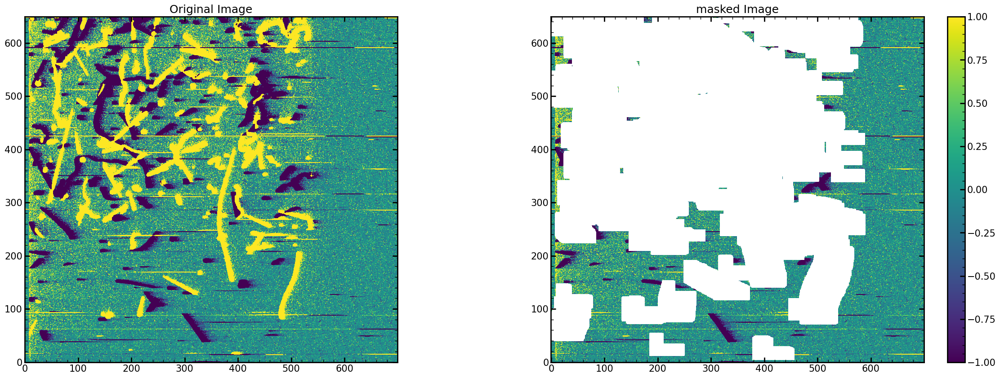

In [ ]:
fig_all, axs_all = plt.subplots(1, 2, figsize=(30, 10))		# Create figures
plt.subplot(121)
plt.title('Original Image')
plt.imshow(data[0],vmin=-1,vmax=1)

plt.subplot(122)
plt.title('masked Image')
plt.imshow(ma.masked_array(data[0], mask=event_halo_mask),vmin=-1,vmax=1)


#cax = plt.axes([0.85, 0.1, 0.075, 0.8])
plt.colorbar()#cax=cax)



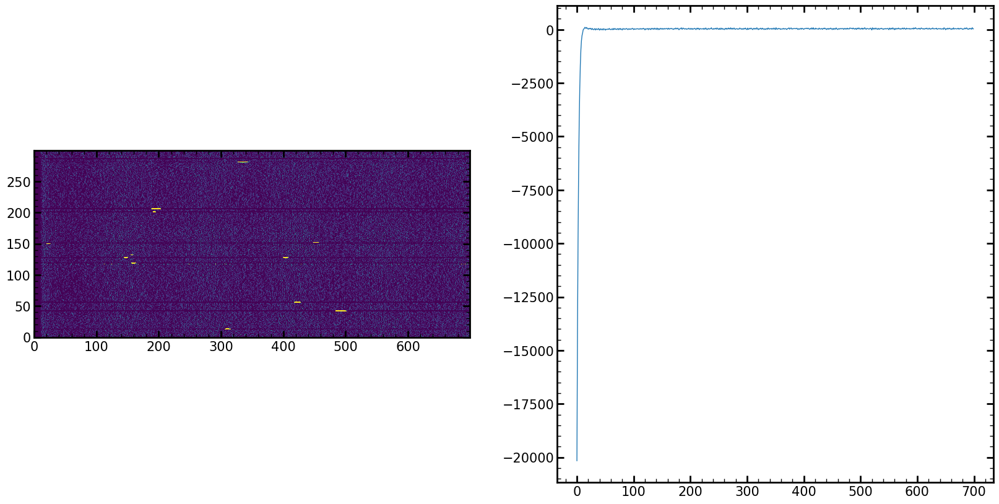

In [ ]:
with open('/home/oem/Software/cursoInstrumentacion_2022/ClasesPy/70 - ICN_LabDet/rows_81_0.npy', 'rb') as f: #Este archivo ya no esta
     rowMatrix = np.load(f)

median=np.median(rowMatrix, axis=0)
mean=np.mean(rowMatrix,axis=0)

fig, axs_all = plt.subplots(1,2, figsize=(20,10))
axs_all[0].imshow(rowMatrix, vmax=1000, vmin=0)
axs_all[1].plot(median)




plt.show()

In [ ]:
x_data=[]
i=0
for value in median:  
            x_data.append(i)
            i+=1
Xdata=np.array(x_data)*.02/86400

In [ ]:
median=median/200

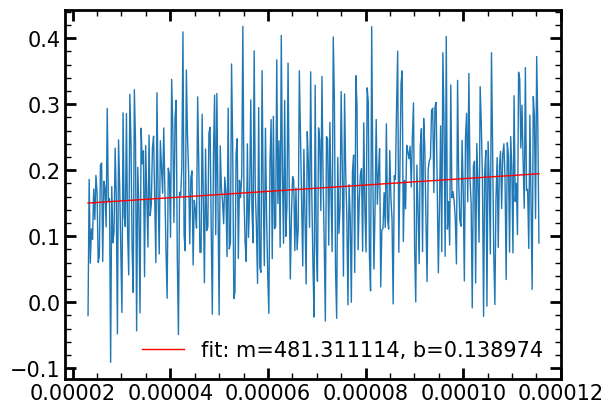

In [ ]:

plt.plot(Xdata[100:500], median[100:500])
popt, pcov = curve_fit(line, Xdata[100:500], median[100:500])
plt.plot(Xdata[100:500], line(Xdata[100:500], popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
plt.legend()

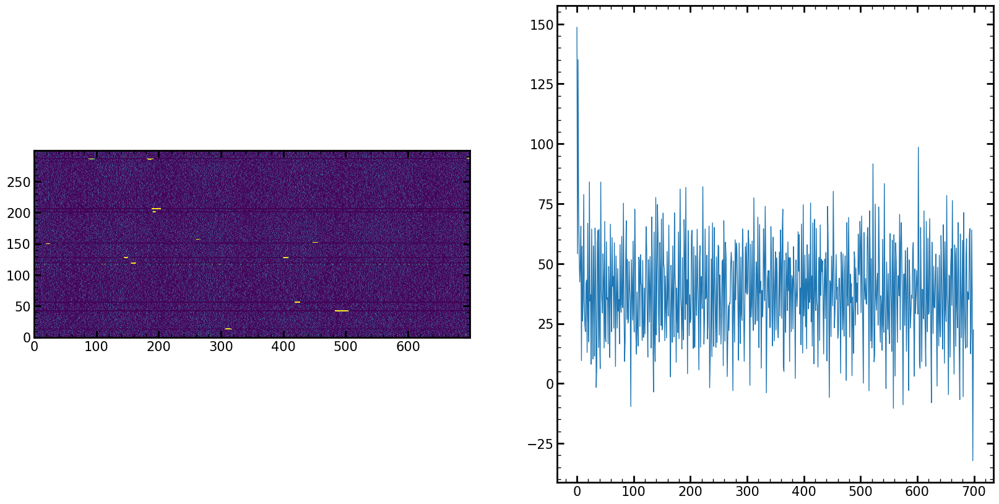

In [ ]:
with open('/home/oem/Software/cursoInstrumentacion_2022/ClasesPy/70 - ICN_LabDet/rows_81_1.npy', 'rb') as f:
     rowMatrix = np.load(f)

median=np.median(rowMatrix, axis=0)
mean=np.mean(rowMatrix,axis=0)

fig, axs_all = plt.subplots(1,2, figsize=(20,10))
axs_all[0].imshow(rowMatrix, vmax=1000, vmin=0)
axs_all[1].plot(median)

median=median/200
plt.show()

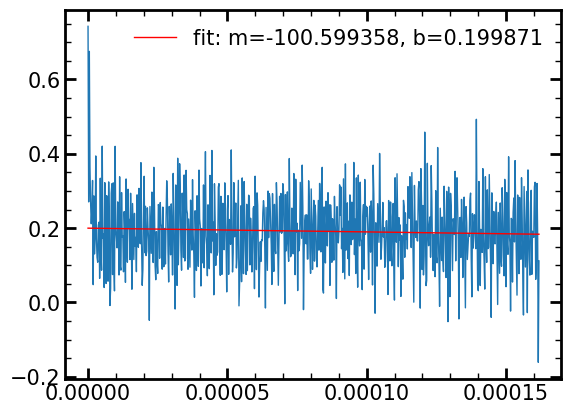

In [ ]:
plt.plot(Xdata, median)
popt, pcov = curve_fit(line, Xdata, median)
plt.plot(Xdata, line(Xdata, popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
plt.legend()

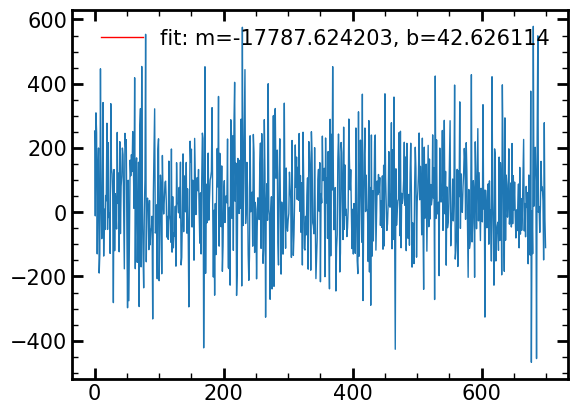

In [ ]:
plt.plot(rowMatrix[10])
popt, pcov = curve_fit(line, Xdata, rowMatrix[10])
plt.plot(Xdata, line(Xdata, popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
plt.legend()

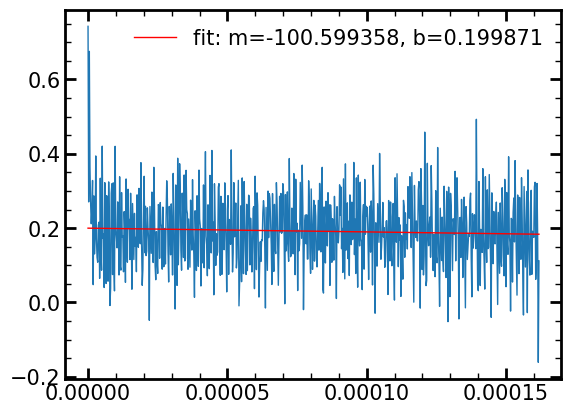

In [ ]:

#plt.plot(Xdata[100:500], median[100:500])
plt.plot(Xdata, median)
popt, pcov = curve_fit(line, Xdata, median)
plt.plot(Xdata, line(Xdata, popt[0], popt[1]), 'r-', label='fit: m=%f, b=%f' % tuple(popt)) #plot de xdata vs f(xdata)
plt.legend()

# Notas para el seminario de Alexis Feb/marzo 23

Filename: /home/oem/datosFits/07SEP2022/proc_skp_mod9_wfr13_Vvtest_vthswings2.5_sh2.5_oh-2.5_EXPOSURE7200_NSAMP4_NROW1300_NCOL1200_img_10.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     165   (1200, 1300)   float32   
  1                1 ImageHDU       164   (1200, 1300)   float32   
  2                1 ImageHDU       164   (1200, 1300)   float32   
  3                1 ImageHDU       164   (1200, 1300)   float32   
None
----------------


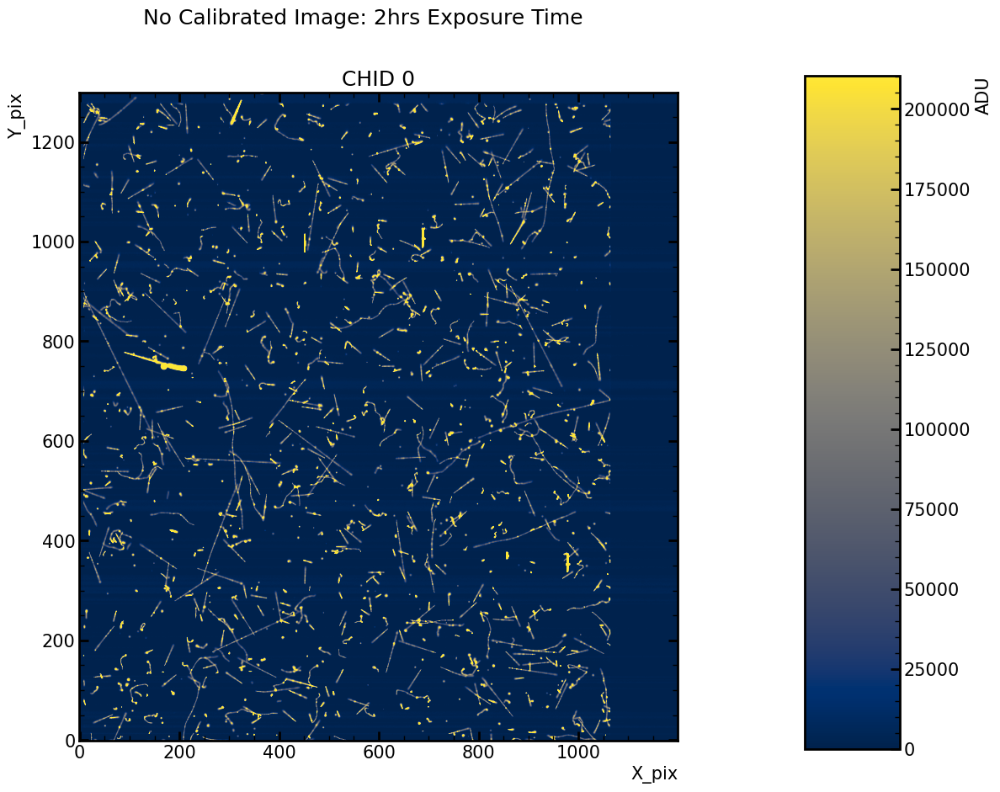

In [ ]:
path='/home/oem/datosFits/07SEP2022/proc_skp_mod9_wfr13_Vvtest_vthswings2.5_sh2.5_oh-2.5_EXPOSURE7200_NSAMP4_NROW1300_NCOL1200_img_10.fits'
hdu_list = fits.open(path)
print(hdu_list.info())
print('----------------')
# hdu_list[0].header
cmap = mpl.cm.cividis

fig=plt.figure(figsize=(15,10))
plt.subplot(1,1,1)

plt.imshow(hdu_list[0].data-np.median(hdu_list[0].data),cmap=cmap,vmin=0,vmax=210500)
plt.title('CHID '+str(0))
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
plt.suptitle('No Calibrated Image: 2hrs Exposure Time')
cax = plt.axes([0.85, 0.1, 0.075, 0.8])
plt.colorbar(cax=cax)
plt.ylabel('ADU')

plt.show()

CHID 0 Gain:(2105.78 +- 173.35)ADUs


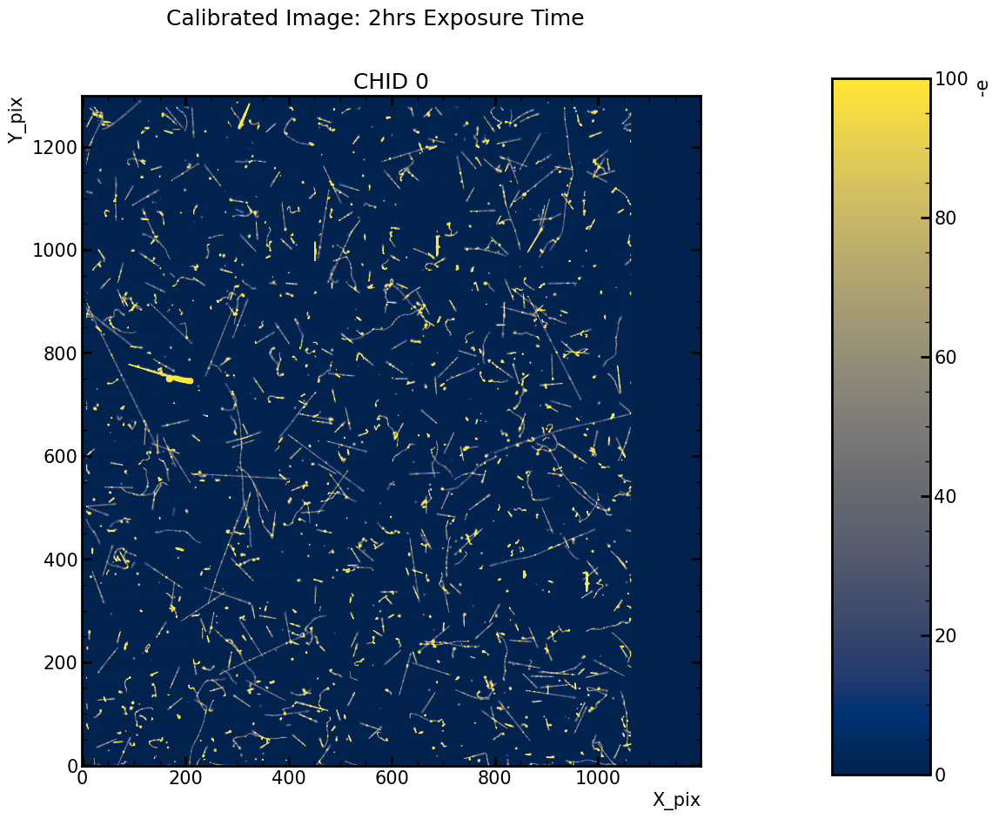

In [ ]:
data_pre = precal(hdu_list,extensions=4)
gain, gain_err, data= LocalCalib(data_pre,extensions=4)
fig=plt.figure(figsize=(15,10))
plt.subplot(1,1,1)

cmap = mpl.cm.cividis
plt.imshow(data[0],cmap=cmap,vmin=0,vmax=100)
plt.title('CHID '+str(0))
plt.ylabel('Y_pix')
plt.xlabel('X_pix')
print("CHID "+str(0)+' Gain:({:.2f} +- {:.2f})ADUs'.format(gain[0],gain_err[0]))
plt.suptitle('Calibrated Image: 2hrs Exposure Time')

cax = plt.axes([0.85, 0.1, 0.075, 0.8])
plt.colorbar(cax=cax)
plt.ylabel('-e')
#plt.savefig('IMAGES_POSCALIB.png', bbox_inches='tight', dpi=100)
    
plt.show()